In [ ]:
import os
os.environ['THEANO_FLAGS'] = 'floatX=float32,device=cuda'


In [ ]:
from PIL import Image
import numpy as np
import tarfile

# 下載 dataset
url = "https://www.cs.toronto.edu/~kriz/cifar-10-python.tar.gz"
import os
import urllib
from urllib.request import urlretrieve
def reporthook(a,b,c):
    print("\rdownloading: %5.1f%%"%(a*b*100.0/c), end="")
tar_gz = "cifar-10-python.tar.gz"
if not os.path.isfile(tar_gz):
        print('Downloading data from %s' % url)
        urlretrieve(url, tar_gz, reporthook=reporthook)

import pickle
train_X=[]
train_y=[]
tar_gz = "cifar-10-python.tar.gz"
with tarfile.open(tar_gz) as tarf:
    for i in range(1, 6):
        dataset = "cifar-10-batches-py/data_batch_%d"%i
        print("load",dataset)
        with tarf.extractfile(dataset) as f:
            result = pickle.load(f, encoding='latin1')
        train_X.extend( result['data'].reshape(-1,3,32,32)/255*2-1)
        train_y.extend(result['labels'])
    train_X=np.float32(train_X)
    train_y=np.int32(train_y)
    dataset = "cifar-10-batches-py/test_batch"
    print("load",dataset)
    with tarf.extractfile(dataset) as f:
        result = pickle.load(f, encoding='latin1')
        test_X=np.float32(result['data'].reshape(-1,3,32,32)/255*2-1)
        test_y=np.int32(result['labels'])
train_X = np.concatenate([train_X, test_X])
train_X = np.concatenate([train_X[:,:,:,::-1], train_X])
train_y = np.concatenate([train_y, test_y, train_y, test_y])
train_Y = np.eye(10).astype('float32')[train_y]

In [ ]:
from IPython.display import display
def showX(X, rows=1):
    assert X.shape[0]%rows == 0
    int_X = ( (X+1)/2*255).clip(0,255).astype('uint8')
    int_X = np.moveaxis(int_X, 1, 3)
    int_X_reshape = int_X.reshape(rows, -1, 32, 32,3).swapaxes(1,2).reshape(rows*32,-1, 3)
    display(Image.fromarray(int_X_reshape))
# 訓練資料， X 的前 20 筆
showX(train_X[:20])
print(train_y[:20])
name_array = np.array("飛機、汽車、鳥、貓、鹿、狗、青蛙、馬、船、卡車".split('、'))
print(name_array[train_y[:20]])

In [ ]:
import numpy as np
import theano
import theano.tensor as T
import lasagne
from lasagne.layers import DenseLayer, DropoutLayer, ReshapeLayer, InputLayer, FlattenLayer, Upscale2DLayer, LocalResponseNormalization2DLayer
floatX = theano.config.floatX
from lasagne.layers import MaxPool2DLayer, Conv2DLayer, TransposedConv2DLayer
from lasagne.layers import batch_norm

In [ ]:
conv_init = lasagne.init.Normal(0.05, 0)
gamma_init = lasagne.init.Normal(0.02, 1)

In [ ]:
def DCGAN_DC(isize, nz, nc, ndf, n_discrete, n_extra_layers=0):
    _ = InputLayer(shape=(None, nc, isize, isize))
    _ = Conv2DLayer(_, num_filters=ndf, filter_size=4, stride=2, pad=1, b=None, W=conv_init, flip_filters=False,
               name = 'initial.conv.{0}-{1}'.format(nc, ndf), 
                nonlinearity=lasagne.nonlinearities.LeakyRectify(0.2))
    csize, cndf = isize // 2, ndf
    while csize > 5:
        in_feat = cndf
        out_feat = cndf*2
        _ = Conv2DLayer(_, num_filters=out_feat, filter_size=4, stride=2, pad=1, b=None, W=conv_init, 
                                   flip_filters=False,
               name = 'pyramid.{0}-{1}.conv'.format(in_feat, out_feat), 
                nonlinearity=lasagne.nonlinearities.LeakyRectify(0.2))
        if 0: # change this line to turn on batch_norm
            _ = batch_norm(_, epsilon=1e-5)
        csize, cndf = csize//2, cndf*2
        
    D = Conv2DLayer(_, num_filters=1, filter_size=csize, stride=1, pad=0, b=None, W=conv_init, 
                    flip_filters=False,
               name = 'final.{0}-{1}.conv'.format(cndf, 1), 
                nonlinearity=None)
    D = FlattenLayer(D)
    C = Conv2DLayer(_, num_filters=cndf, filter_size=csize, stride=1, pad=0, b=None, W=conv_init, 
                    flip_filters=False,
               name = 'final.{0}-{1}.conv'.format(cndf, cndf), 
                nonlinearity=lasagne.nonlinearities.LeakyRectify(0.2))
    C = FlattenLayer(C)
    C = DenseLayer(C, 10, nonlinearity=lasagne.nonlinearities.softmax)    
    return D, C


In [ ]:
def DCGAN_G(isize, nz, nc, ngf, n_extra_layers=0):
    cngf= ngf//2
    tisize = isize
    while tisize > 5:
        cngf = cngf * 2
        tisize = tisize // 2
    _ = InputLayer(shape=(None, nz))
    _ = ReshapeLayer(_, (-1, nz, 1,1))
    _ = TransposedConv2DLayer(_, num_filters=cngf, filter_size=tisize, stride=1, crop=0, b=None, 
                              W=conv_init,
               name =  'initial.{0}-{1}.convt'.format(nz, cngf))
    _ = batch_norm(_, epsilon=1e-5)
    csize, cndf = tisize, cngf
    
    while csize < isize//2:
        in_feat = cngf
        out_feat = cngf//2
        _ = TransposedConv2DLayer(_, num_filters=out_feat, filter_size=4, stride=2, crop=1, b=None, W=conv_init,
               name = 'pyramid.{0}-{1}.convt'.format(in_feat, out_feat))
        _ = batch_norm(_, epsilon=1e-5)
        csize, cngf = csize*2, cngf//2
    _ = TransposedConv2DLayer(_, num_filters=nc, filter_size=4, stride=2, crop=1, b=None, W=conv_init,
               name = 'final.{0}-{1}.convt'.format(cngf, nc), nonlinearity=lasagne.nonlinearities.tanh)       
    return _


In [ ]:
nc = 3
nz = 32
n_discrete = 10
ngf = 64
ndf = 64
n_extra_layers = 0
Diters = 5

imageSize = 32
batchSize = 64
lrD = 1e-4
lrG = 1e-4
clamp_lower, clamp_upper = -0.01, 0.01

In [ ]:
netD, netC = DCGAN_DC(imageSize, nz, nc, ndf, n_discrete, n_extra_layers)
for l in lasagne.layers.get_all_layers(netD):
    print(l.name,  l.output_shape)
print()
for l in lasagne.layers.get_all_layers(netC):
    print(l.name,  l.output_shape)

In [ ]:
netG = DCGAN_G(imageSize, nz, nc, ngf, n_extra_layers)
for l in lasagne.layers.get_all_layers(netG):
    print(l.name,  l.output_shape)

In [ ]:
input_var_D = lasagne.layers.get_all_layers(netD)[0].input_var
input_var_G = lasagne.layers.get_all_layers(netG)[0].input_var
input_var_Y = T.matrix()
ϵ = T.TensorType(dtype=floatX,broadcastable=(False, True, True, True))()


In [ ]:
no_bn_avg = dict(       batch_norm_update_averages=False,
                       batch_norm_use_averages=False)
output_D = lasagne.layers.get_output(netD, **no_bn_avg)
output_G = lasagne.layers.get_output(netG, **no_bn_avg)

output_D_fake = lasagne.layers.get_output(netD, inputs=output_G, **no_bn_avg)
output_C_fake = lasagne.layers.get_output(netC, inputs=output_G, **no_bn_avg)
output_C = lasagne.layers.get_output(netC, inputs=input_var_D, **no_bn_avg)

In [ ]:
mixed_X = (ϵ * output_G) + (1-ϵ) * input_var_D

In [ ]:
output_D_mixed = lasagne.layers.get_output(netD, inputs=mixed_X, **no_bn_avg)

In [ ]:
grad_mixed = T.grad(T.sum(output_D_mixed), mixed_X)
norm_grad_mixed = T.sqrt(T.sum(T.square(grad_mixed),axis=[1,2,3]))
grad_penalty = T.mean(T.square(norm_grad_mixed -1))

In [ ]:
loss_C_fake = lasagne.objectives.categorical_crossentropy(output_C_fake, 
                                                input_var_G[:, :n_discrete]).mean()

loss_C_real = lasagne.objectives.categorical_crossentropy(output_C, 
                                                input_var_Y).mean()


loss_D_real = output_D.mean()
loss_D_fake = output_D_fake.mean()
loss_D = loss_D_fake - loss_D_real
loss_D_gp = loss_D + 10 * grad_penalty + 0.01*loss_C_real
loss_G = -loss_D_fake + loss_C_fake


params_netD = lasagne.layers.get_all_params(netD, trainable=True) 
params_netC = lasagne.layers.get_all_params(netC, trainable=True) 
params_netG = lasagne.layers.get_all_params(netG, trainable=True)
optimize_G = lasagne.updates.adam(loss_G, params_netG, learning_rate=lrG, beta1=0.)
optimize_D = lasagne.updates.adam(loss_D_gp, params_netD+params_netC, 
                                  learning_rate=lrD, beta1=0.)
train_G_fn =  theano.function([input_var_G], [loss_G], updates=optimize_G)
train_D_fn = theano.function([input_var_D, input_var_G, input_var_Y, ϵ], 
                              [loss_D_gp, loss_D, loss_D_real, loss_D_fake, loss_C_fake], 
                                         updates=optimize_D)
generator_fn = theano.function([input_var_G], output_G)

In [17]:
def noise_generator(batchSize, nz, num_discrete, random_y=None):
    noise = np.zeros(shape=(batchSize, nz), dtype='float32')
    noise[:, num_discrete:] = np.random.normal(size=(batchSize, nz-num_discrete))
    if random_y is None:
        random_y = np.random.randint(0, num_discrete, size=batchSize)
    else:
        assert len(random_y) == batchSize
    noise[np.arange(batchSize), random_y] = 1
    return noise
    

fixed_noise = noise_generator(n_discrete*10, nz, n_discrete, [i//10 for i in range(100)])

[185/1000][390/1875][66500] Loss_D: -2.629618 Loss_G: -0.342364 
Loss_D_real: 3.354394 Loss_D_fake 0.724777 Loss_C_fake 0.247532 10092.025095701218
[186/1000][1110/1875][67000] Loss_D: -3.021037 Loss_G: 1.366046 
Loss_D_real: 1.956717 Loss_D_fake -1.064320 Loss_C_fake 0.024107 10167.458297491074


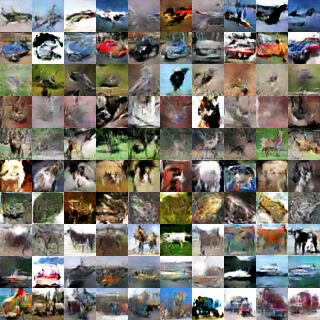

[187/1000][1830/1875][67500] Loss_D: -2.599555 Loss_G: 1.390058 
Loss_D_real: 1.485425 Loss_D_fake -1.114130 Loss_C_fake 0.056937 10242.917096614838
[189/1000][675/1875][68000] Loss_D: -2.298522 Loss_G: 1.523917 
Loss_D_real: 1.209463 Loss_D_fake -1.089059 Loss_C_fake 0.054031 10318.353355407715
[190/1000][1395/1875][68500] Loss_D: -2.086474 Loss_G: -0.561613 
Loss_D_real: 2.394367 Loss_D_fake 0.307893 Loss_C_fake 0.001112 10393.792859315872
[192/1000][240/1875][69000] Loss_D: -1.992237 Loss_G: 1.083307 
Loss_D_real: 1.300049 Loss_D_fake -0.692187 Loss_C_fake 0.087956 10469.246362447739
[193/1000][960/1875][69500] Loss_D: -2.922812 Loss_G: 0.013839 
Loss_D_real: 3.370876 Loss_D_fake 0.448064 Loss_C_fake 0.033124 10544.680477142334


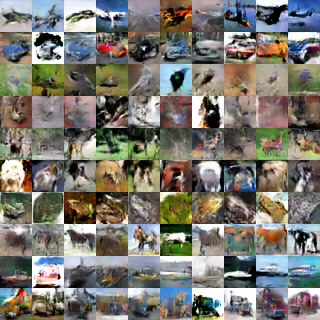

[194/1000][1680/1875][70000] Loss_D: -2.014818 Loss_G: 1.530430 
Loss_D_real: 0.951494 Loss_D_fake -1.063324 Loss_C_fake 0.004006 10620.151556015015
[196/1000][525/1875][70500] Loss_D: -2.273441 Loss_G: 2.204452 
Loss_D_real: -0.093078 Loss_D_fake -2.366519 Loss_C_fake 0.009713 10695.590372562408
[197/1000][1245/1875][71000] Loss_D: -1.870638 Loss_G: 0.318026 
Loss_D_real: 1.276539 Loss_D_fake -0.594099 Loss_C_fake 0.156660 10771.033935785294
[198/1000][1875/1875][71500] Loss_D: -2.267829 Loss_G: -0.549656 
Loss_D_real: 2.416667 Loss_D_fake 0.148838 Loss_C_fake 0.257860 10844.028590917587
[200/1000][720/1875][72000] Loss_D: -2.914793 Loss_G: 1.662963 
Loss_D_real: 1.897910 Loss_D_fake -1.016883 Loss_C_fake 0.084627 10919.46470284462


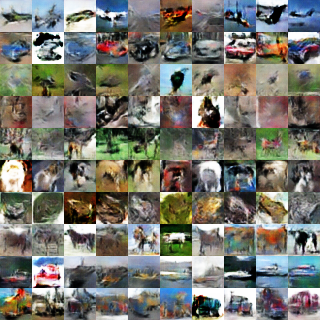

[201/1000][1440/1875][72500] Loss_D: -2.022697 Loss_G: 0.605981 
Loss_D_real: 1.726667 Loss_D_fake -0.296030 Loss_C_fake 0.000942 10994.933104991913
[203/1000][285/1875][73000] Loss_D: -2.226222 Loss_G: 0.798892 
Loss_D_real: 1.671545 Loss_D_fake -0.554677 Loss_C_fake 0.529646 11070.370305299759
[204/1000][1005/1875][73500] Loss_D: -1.934168 Loss_G: -0.070899 
Loss_D_real: 2.997376 Loss_D_fake 1.063209 Loss_C_fake 0.161533 11145.803226709366
[205/1000][1725/1875][74000] Loss_D: -2.532470 Loss_G: 1.342190 
Loss_D_real: 1.010527 Loss_D_fake -1.521944 Loss_C_fake 0.169635 11221.248120546341
[207/1000][570/1875][74500] Loss_D: -2.379352 Loss_G: 0.558723 
Loss_D_real: 1.360558 Loss_D_fake -1.018793 Loss_C_fake 0.106449 11296.683634519577


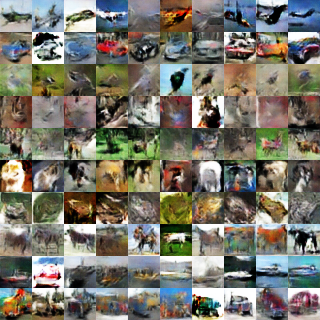

[208/1000][1290/1875][75000] Loss_D: -2.128172 Loss_G: 0.890798 
Loss_D_real: 1.972890 Loss_D_fake -0.155282 Loss_C_fake 0.101384 11372.14693903923
[210/1000][135/1875][75500] Loss_D: -2.163912 Loss_G: -0.082081 
Loss_D_real: 2.236418 Loss_D_fake 0.072507 Loss_C_fake 0.097940 11447.593356609344
[211/1000][855/1875][76000] Loss_D: -2.313648 Loss_G: 0.156628 
Loss_D_real: 2.459643 Loss_D_fake 0.145995 Loss_C_fake 0.176253 11523.027673244476
[212/1000][1575/1875][76500] Loss_D: -2.467114 Loss_G: 1.271901 
Loss_D_real: 1.123744 Loss_D_fake -1.343370 Loss_C_fake 0.209385 11598.468620538712
[214/1000][420/1875][77000] Loss_D: -2.543166 Loss_G: 1.257606 
Loss_D_real: 1.566717 Loss_D_fake -0.976449 Loss_C_fake 0.002506 11673.90551328659


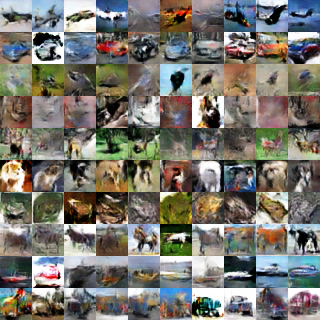

[215/1000][1140/1875][77500] Loss_D: -2.400362 Loss_G: 1.024240 
Loss_D_real: 1.421869 Loss_D_fake -0.978493 Loss_C_fake 0.050115 11749.37258887291
[216/1000][1860/1875][78000] Loss_D: -2.091256 Loss_G: 0.718676 
Loss_D_real: 1.571878 Loss_D_fake -0.519378 Loss_C_fake 0.071897 11824.805096387863
[218/1000][705/1875][78500] Loss_D: -2.228185 Loss_G: 0.509596 
Loss_D_real: 1.872408 Loss_D_fake -0.355777 Loss_C_fake 0.013396 11900.24731349945
[219/1000][1425/1875][79000] Loss_D: -2.480433 Loss_G: -0.429791 
Loss_D_real: 3.285928 Loss_D_fake 0.805496 Loss_C_fake 0.040724 11975.681853055954
[221/1000][270/1875][79500] Loss_D: -2.547724 Loss_G: 0.653877 
Loss_D_real: 1.958158 Loss_D_fake -0.589566 Loss_C_fake 0.224864 12051.123614311218


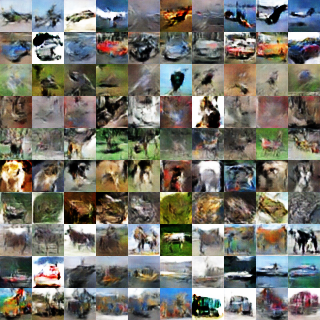

[222/1000][990/1875][80000] Loss_D: -2.017350 Loss_G: -0.083503 
Loss_D_real: 2.713547 Loss_D_fake 0.696198 Loss_C_fake 0.103259 12126.587273359299
[223/1000][1710/1875][80500] Loss_D: -1.991061 Loss_G: 2.132689 
Loss_D_real: -0.050525 Loss_D_fake -2.041586 Loss_C_fake 0.094406 12202.027334451675
[225/1000][555/1875][81000] Loss_D: -1.654217 Loss_G: 0.739402 
Loss_D_real: 1.225794 Loss_D_fake -0.428423 Loss_C_fake 0.015908 12277.466839075089
[226/1000][1275/1875][81500] Loss_D: -2.264577 Loss_G: 1.723160 
Loss_D_real: 0.260072 Loss_D_fake -2.004505 Loss_C_fake 0.165747 12352.912530899048
[228/1000][120/1875][82000] Loss_D: -1.947330 Loss_G: 0.049286 
Loss_D_real: 1.737022 Loss_D_fake -0.210308 Loss_C_fake 0.186160 12428.344470739365


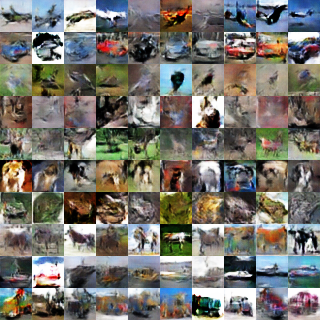

[229/1000][840/1875][82500] Loss_D: -2.499645 Loss_G: -0.468847 
Loss_D_real: 3.163929 Loss_D_fake 0.664285 Loss_C_fake 0.094480 12503.813955783844
[230/1000][1560/1875][83000] Loss_D: -2.372387 Loss_G: 2.660169 
Loss_D_real: 0.009542 Loss_D_fake -2.362845 Loss_C_fake 0.193379 12579.256558656693
[232/1000][405/1875][83500] Loss_D: -1.922093 Loss_G: 0.527128 
Loss_D_real: 1.414665 Loss_D_fake -0.507427 Loss_C_fake 0.161039 12654.68772482872
[233/1000][1125/1875][84000] Loss_D: -1.703744 Loss_G: -0.529985 
Loss_D_real: 2.563317 Loss_D_fake 0.859572 Loss_C_fake 0.093342 12730.12502360344
[234/1000][1845/1875][84500] Loss_D: -1.784741 Loss_G: -0.812027 
Loss_D_real: 2.463792 Loss_D_fake 0.679051 Loss_C_fake 0.132195 12805.56227850914


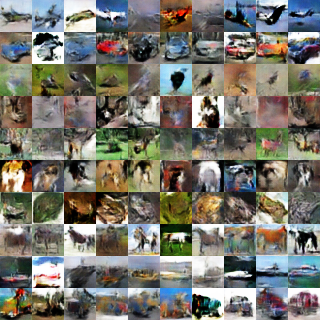

[236/1000][690/1875][85000] Loss_D: -2.068538 Loss_G: 1.805701 
Loss_D_real: 0.871891 Loss_D_fake -1.196647 Loss_C_fake 0.634025 12881.021394252777
[237/1000][1410/1875][85500] Loss_D: -2.608523 Loss_G: 0.808578 
Loss_D_real: 1.661404 Loss_D_fake -0.947119 Loss_C_fake 0.001362 12956.469433784485
[239/1000][255/1875][86000] Loss_D: -2.083570 Loss_G: 0.316614 
Loss_D_real: 1.011989 Loss_D_fake -1.071581 Loss_C_fake 0.175103 13031.915667295456
[240/1000][975/1875][86500] Loss_D: -2.550825 Loss_G: 1.432629 
Loss_D_real: 0.513122 Loss_D_fake -2.037703 Loss_C_fake 0.151478 13107.350201368332
[241/1000][1695/1875][87000] Loss_D: -2.025391 Loss_G: 1.327739 
Loss_D_real: 0.668303 Loss_D_fake -1.357088 Loss_C_fake 0.083151 13182.783659219742


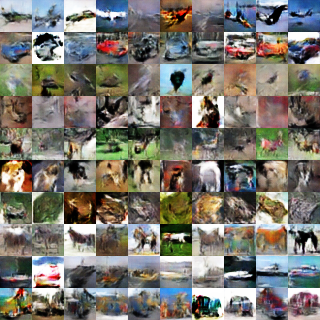

[243/1000][540/1875][87500] Loss_D: -2.253720 Loss_G: 1.897511 
Loss_D_real: 0.226586 Loss_D_fake -2.027134 Loss_C_fake 0.054261 13258.25350022316
[244/1000][1260/1875][88000] Loss_D: -1.744967 Loss_G: 0.911981 
Loss_D_real: 0.790835 Loss_D_fake -0.954132 Loss_C_fake 0.020494 13333.688217878342
[246/1000][105/1875][88500] Loss_D: -2.378414 Loss_G: 0.947766 
Loss_D_real: 1.584068 Loss_D_fake -0.794347 Loss_C_fake 0.024019 13409.130497932434
[247/1000][825/1875][89000] Loss_D: -2.395053 Loss_G: -0.458759 
Loss_D_real: 2.738572 Loss_D_fake 0.343518 Loss_C_fake 0.082577 13484.57130599022
[248/1000][1545/1875][89500] Loss_D: -2.285568 Loss_G: 2.499908 
Loss_D_real: -0.524078 Loss_D_fake -2.809646 Loss_C_fake 0.015966 13560.010387420654


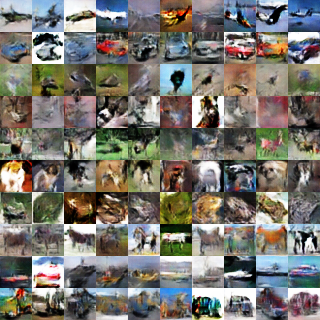

[250/1000][390/1875][90000] Loss_D: -2.230608 Loss_G: 0.251862 
Loss_D_real: 2.369229 Loss_D_fake 0.138620 Loss_C_fake 0.017903 13635.475704193115
[251/1000][1110/1875][90500] Loss_D: -2.105579 Loss_G: 1.017934 
Loss_D_real: 2.452128 Loss_D_fake 0.346549 Loss_C_fake 0.117992 13710.916028499603
[252/1000][1830/1875][91000] Loss_D: -2.288636 Loss_G: 0.724844 
Loss_D_real: 1.828413 Loss_D_fake -0.460223 Loss_C_fake 0.178413 13786.352201223373
[254/1000][675/1875][91500] Loss_D: -2.348573 Loss_G: 1.417691 
Loss_D_real: 0.573542 Loss_D_fake -1.775031 Loss_C_fake 0.015513 13861.792912960052
[255/1000][1395/1875][92000] Loss_D: -2.009043 Loss_G: -1.317333 
Loss_D_real: 3.101908 Loss_D_fake 1.092865 Loss_C_fake 0.002526 13937.228519678116


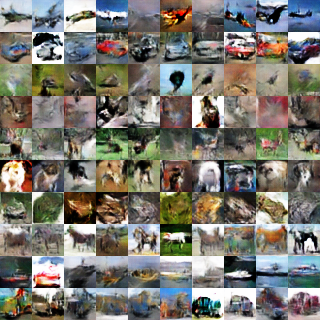

[257/1000][240/1875][92500] Loss_D: -1.858342 Loss_G: 0.999409 
Loss_D_real: 1.278174 Loss_D_fake -0.580168 Loss_C_fake 0.041963 14012.68476319313
[258/1000][960/1875][93000] Loss_D: -2.321357 Loss_G: 0.102073 
Loss_D_real: 2.732848 Loss_D_fake 0.411491 Loss_C_fake 0.000105 14088.128554821014
[259/1000][1680/1875][93500] Loss_D: -2.129988 Loss_G: -1.107662 
Loss_D_real: 2.926403 Loss_D_fake 0.796415 Loss_C_fake 0.430967 14163.570357084274
[261/1000][525/1875][94000] Loss_D: -1.954107 Loss_G: 2.383271 
Loss_D_real: -0.008439 Loss_D_fake -1.962546 Loss_C_fake 0.044723 14239.01545882225
[262/1000][1245/1875][94500] Loss_D: -1.578576 Loss_G: -0.407114 
Loss_D_real: 2.043945 Loss_D_fake 0.465369 Loss_C_fake 0.021567 14314.461805582047


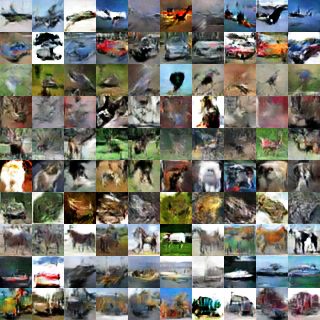

[263/1000][1875/1875][95000] Loss_D: -2.295871 Loss_G: -0.785306 
Loss_D_real: 2.893491 Loss_D_fake 0.597619 Loss_C_fake 0.192607 14387.481512069702
[265/1000][720/1875][95500] Loss_D: -2.472230 Loss_G: 1.572580 
Loss_D_real: 1.069227 Loss_D_fake -1.403004 Loss_C_fake 0.140762 14462.926305532455
[266/1000][1440/1875][96000] Loss_D: -2.454958 Loss_G: 0.003184 
Loss_D_real: 2.534633 Loss_D_fake 0.079675 Loss_C_fake 0.029006 14538.364747285843
[268/1000][285/1875][96500] Loss_D: -1.502514 Loss_G: 0.828768 
Loss_D_real: 0.613632 Loss_D_fake -0.888882 Loss_C_fake 0.047810 14613.80292391777
[269/1000][1005/1875][97000] Loss_D: -1.939057 Loss_G: 0.220143 
Loss_D_real: 2.511110 Loss_D_fake 0.572054 Loss_C_fake 0.309420 14689.241485118866


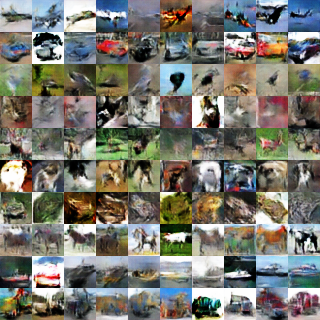

[270/1000][1725/1875][97500] Loss_D: -1.814470 Loss_G: 1.061028 
Loss_D_real: 0.617321 Loss_D_fake -1.197149 Loss_C_fake 0.062287 14764.704809427261
[272/1000][570/1875][98000] Loss_D: -1.774234 Loss_G: 1.703658 
Loss_D_real: 0.145317 Loss_D_fake -1.628917 Loss_C_fake 0.001822 14840.148566246033
[273/1000][1290/1875][98500] Loss_D: -2.001119 Loss_G: -0.249994 
Loss_D_real: 2.383330 Loss_D_fake 0.382211 Loss_C_fake 0.000186 14915.581963777542
[275/1000][135/1875][99000] Loss_D: -1.926265 Loss_G: 1.391855 
Loss_D_real: 1.081321 Loss_D_fake -0.844945 Loss_C_fake 0.075471 14991.01674246788
[276/1000][855/1875][99500] Loss_D: -2.358654 Loss_G: -0.196580 
Loss_D_real: 2.232258 Loss_D_fake -0.126396 Loss_C_fake 0.015450 15066.45260477066


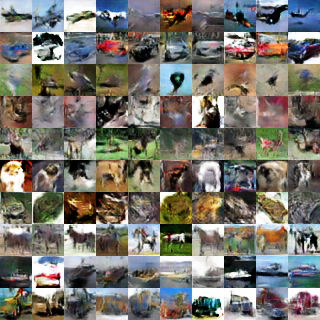

[277/1000][1575/1875][100000] Loss_D: -2.768587 Loss_G: 3.506753 
Loss_D_real: -0.780629 Loss_D_fake -3.549216 Loss_C_fake 0.136881 15141.90935921669
[279/1000][420/1875][100500] Loss_D: -2.540066 Loss_G: 0.063606 
Loss_D_real: 2.555390 Loss_D_fake 0.015325 Loss_C_fake 0.033405 15217.338418960571
[280/1000][1140/1875][101000] Loss_D: -1.952606 Loss_G: -0.238193 
Loss_D_real: 1.983531 Loss_D_fake 0.030925 Loss_C_fake 0.054804 15292.780616521835
[281/1000][1860/1875][101500] Loss_D: -1.991740 Loss_G: 0.787851 
Loss_D_real: 1.156041 Loss_D_fake -0.835699 Loss_C_fake 0.131409 15368.213663816452
[283/1000][705/1875][102000] Loss_D: -1.969513 Loss_G: 0.712015 
Loss_D_real: 1.597541 Loss_D_fake -0.371972 Loss_C_fake 0.062595 15443.649560213089


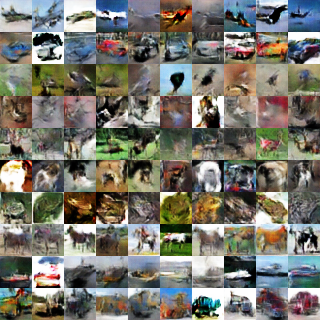

[284/1000][1425/1875][102500] Loss_D: -2.783137 Loss_G: 0.484391 
Loss_D_real: 1.823925 Loss_D_fake -0.959212 Loss_C_fake 0.127120 15519.108181715012
[286/1000][270/1875][103000] Loss_D: -2.377730 Loss_G: -0.147922 
Loss_D_real: 1.988630 Loss_D_fake -0.389100 Loss_C_fake 0.059558 15594.543308258057
[287/1000][990/1875][103500] Loss_D: -2.227818 Loss_G: 0.966162 
Loss_D_real: 1.312146 Loss_D_fake -0.915671 Loss_C_fake 0.001708 15669.974788188934
[288/1000][1710/1875][104000] Loss_D: -1.741731 Loss_G: 2.235149 
Loss_D_real: 0.095739 Loss_D_fake -1.645992 Loss_C_fake 0.151088 15745.409371852875
[290/1000][555/1875][104500] Loss_D: -1.778265 Loss_G: 1.347240 
Loss_D_real: 1.049329 Loss_D_fake -0.728936 Loss_C_fake 0.000043 15820.847589969635


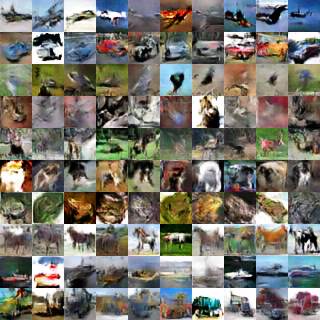

[291/1000][1275/1875][105000] Loss_D: -2.159335 Loss_G: 1.939640 
Loss_D_real: 0.187519 Loss_D_fake -1.971816 Loss_C_fake 0.031885 15896.310460329056
[293/1000][120/1875][105500] Loss_D: -1.649349 Loss_G: -0.943543 
Loss_D_real: 2.688373 Loss_D_fake 1.039024 Loss_C_fake 0.192946 15971.748834609985
[294/1000][840/1875][106000] Loss_D: -1.748052 Loss_G: 0.266479 
Loss_D_real: 1.721476 Loss_D_fake -0.026576 Loss_C_fake 0.387883 16047.186057806015
[295/1000][1560/1875][106500] Loss_D: -2.564297 Loss_G: 2.242914 
Loss_D_real: 0.315231 Loss_D_fake -2.249067 Loss_C_fake 0.120426 16122.625353097916
[297/1000][405/1875][107000] Loss_D: -1.692617 Loss_G: -0.582111 
Loss_D_real: 2.097646 Loss_D_fake 0.405029 Loss_C_fake 0.080863 16198.0505027771


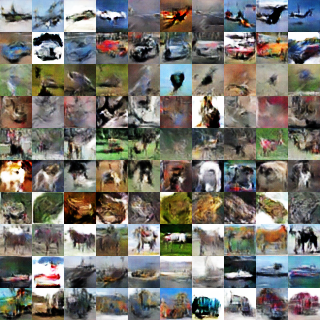

[298/1000][1125/1875][107500] Loss_D: -1.656541 Loss_G: -0.179555 
Loss_D_real: 2.460613 Loss_D_fake 0.804073 Loss_C_fake 0.004706 16273.518518686295
[299/1000][1845/1875][108000] Loss_D: -2.318328 Loss_G: 0.604539 
Loss_D_real: 1.399029 Loss_D_fake -0.919299 Loss_C_fake 0.097395 16348.950031042099
[301/1000][690/1875][108500] Loss_D: -2.456465 Loss_G: 1.393856 
Loss_D_real: 0.849703 Loss_D_fake -1.606762 Loss_C_fake 0.013897 16424.388191461563
[302/1000][1410/1875][109000] Loss_D: -1.778368 Loss_G: -1.890560 
Loss_D_real: 3.905552 Loss_D_fake 2.127184 Loss_C_fake 0.145469 16499.826585531235
[304/1000][255/1875][109500] Loss_D: -2.076632 Loss_G: -0.335017 
Loss_D_real: 1.599671 Loss_D_fake -0.476960 Loss_C_fake 0.012277 16575.25918531418


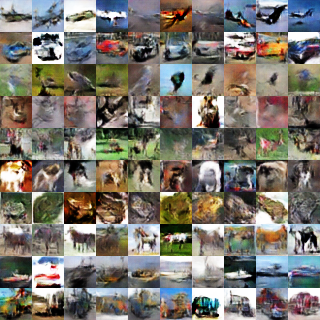

[305/1000][975/1875][110000] Loss_D: -1.939035 Loss_G: 1.487949 
Loss_D_real: 0.404848 Loss_D_fake -1.534188 Loss_C_fake 0.046868 16650.724564790726
[306/1000][1695/1875][110500] Loss_D: -2.122393 Loss_G: 2.253789 
Loss_D_real: 0.067841 Loss_D_fake -2.054552 Loss_C_fake 0.110509 16726.156656742096
[308/1000][540/1875][111000] Loss_D: -2.331798 Loss_G: -0.179065 
Loss_D_real: 2.108314 Loss_D_fake -0.223484 Loss_C_fake 0.005051 16801.59969186783
[309/1000][1260/1875][111500] Loss_D: -1.555153 Loss_G: 1.592314 
Loss_D_real: -0.193642 Loss_D_fake -1.748795 Loss_C_fake 0.221986 16877.040384292603
[311/1000][105/1875][112000] Loss_D: -2.355237 Loss_G: 0.962366 
Loss_D_real: 1.501487 Loss_D_fake -0.853751 Loss_C_fake 0.082933 16952.47378873825


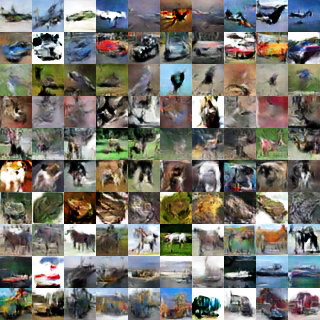

[312/1000][825/1875][112500] Loss_D: -2.100558 Loss_G: -1.056470 
Loss_D_real: 1.561129 Loss_D_fake -0.539428 Loss_C_fake 0.198478 17027.938073158264
[313/1000][1545/1875][113000] Loss_D: -1.945784 Loss_G: 1.400881 
Loss_D_real: 0.653159 Loss_D_fake -1.292625 Loss_C_fake 0.039806 17103.375106811523
[315/1000][390/1875][113500] Loss_D: -2.326467 Loss_G: -0.697878 
Loss_D_real: 3.355154 Loss_D_fake 1.028687 Loss_C_fake 0.004623 17178.805641889572
[316/1000][1110/1875][114000] Loss_D: -1.917222 Loss_G: 1.343147 
Loss_D_real: 0.421703 Loss_D_fake -1.495520 Loss_C_fake 0.056999 17254.238152980804
[317/1000][1830/1875][114500] Loss_D: -2.127409 Loss_G: 1.266365 
Loss_D_real: 1.556495 Loss_D_fake -0.570914 Loss_C_fake 0.004871 17329.667110204697


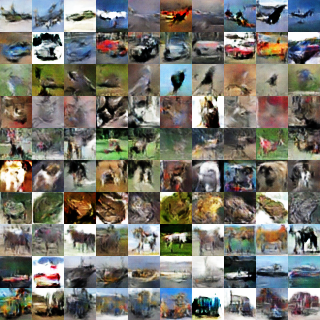

[319/1000][675/1875][115000] Loss_D: -2.174506 Loss_G: 0.068978 
Loss_D_real: 1.958229 Loss_D_fake -0.216278 Loss_C_fake 0.210018 17405.13123345375
[320/1000][1395/1875][115500] Loss_D: -1.901840 Loss_G: 0.200019 
Loss_D_real: 1.521183 Loss_D_fake -0.380657 Loss_C_fake 0.003216 17480.569849967957
[322/1000][240/1875][116000] Loss_D: -1.961876 Loss_G: 0.936450 
Loss_D_real: 2.213406 Loss_D_fake 0.251531 Loss_C_fake 0.017338 17556.010033607483
[323/1000][960/1875][116500] Loss_D: -2.003521 Loss_G: -1.197914 
Loss_D_real: 2.975199 Loss_D_fake 0.971678 Loss_C_fake 0.072048 17631.44313430786
[324/1000][1680/1875][117000] Loss_D: -1.981315 Loss_G: 1.649777 
Loss_D_real: 0.609020 Loss_D_fake -1.372295 Loss_C_fake 0.126781 17706.883418560028


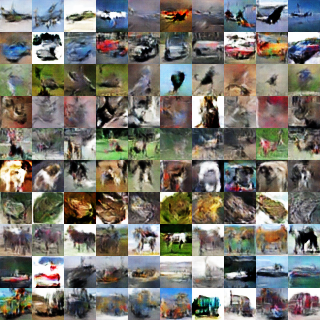

[326/1000][525/1875][117500] Loss_D: -2.265158 Loss_G: 2.061367 
Loss_D_real: 0.262711 Loss_D_fake -2.002447 Loss_C_fake 0.004919 17782.351875066757
[327/1000][1245/1875][118000] Loss_D: -1.096174 Loss_G: -1.031490 
Loss_D_real: 2.430749 Loss_D_fake 1.334576 Loss_C_fake 0.099993 17857.788111448288
[328/1000][1875/1875][118500] Loss_D: -2.004369 Loss_G: -0.146669 
Loss_D_real: 2.322845 Loss_D_fake 0.318475 Loss_C_fake 0.184469 17930.787713050842
[330/1000][720/1875][119000] Loss_D: -2.155841 Loss_G: 1.143335 
Loss_D_real: 1.159580 Loss_D_fake -0.996261 Loss_C_fake 0.032497 18006.229556560516
[331/1000][1440/1875][119500] Loss_D: -2.573567 Loss_G: 0.273075 
Loss_D_real: 1.845437 Loss_D_fake -0.728130 Loss_C_fake 0.002121 18081.672452926636


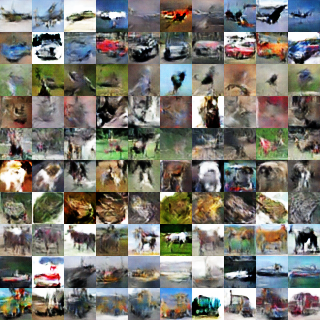

[333/1000][285/1875][120000] Loss_D: -2.212033 Loss_G: 1.194578 
Loss_D_real: 0.898782 Loss_D_fake -1.313251 Loss_C_fake 0.395525 18157.132680416107
[334/1000][1005/1875][120500] Loss_D: -2.081782 Loss_G: -0.966306 
Loss_D_real: 3.153767 Loss_D_fake 1.071985 Loss_C_fake 0.001917 18232.573345422745
[335/1000][1725/1875][121000] Loss_D: -1.565050 Loss_G: -0.021584 
Loss_D_real: 1.436097 Loss_D_fake -0.128954 Loss_C_fake 0.090515 18308.01024222374
[337/1000][570/1875][121500] Loss_D: -2.213293 Loss_G: 0.071001 
Loss_D_real: 2.008125 Loss_D_fake -0.205168 Loss_C_fake 0.317051 18383.44957089424
[338/1000][1290/1875][122000] Loss_D: -1.960874 Loss_G: -0.926714 
Loss_D_real: 2.832271 Loss_D_fake 0.871397 Loss_C_fake 0.333408 18458.889429092407


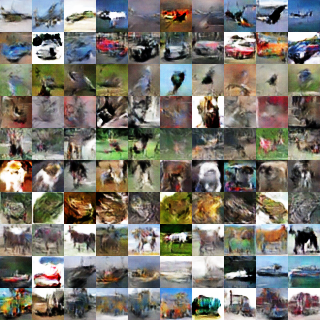

[340/1000][135/1875][122500] Loss_D: -1.789006 Loss_G: -0.678769 
Loss_D_real: 2.691168 Loss_D_fake 0.902162 Loss_C_fake 0.325606 18534.359694242477
[341/1000][855/1875][123000] Loss_D: -1.689693 Loss_G: -0.389248 
Loss_D_real: 2.438751 Loss_D_fake 0.749057 Loss_C_fake 0.221378 18609.805978536606
[342/1000][1575/1875][123500] Loss_D: -2.236127 Loss_G: 1.964815 
Loss_D_real: 0.523216 Loss_D_fake -1.712911 Loss_C_fake 0.052628 18685.24642276764
[344/1000][420/1875][124000] Loss_D: -2.581862 Loss_G: 0.195316 
Loss_D_real: 2.949358 Loss_D_fake 0.367496 Loss_C_fake 0.098134 18760.695584774017
[345/1000][1140/1875][124500] Loss_D: -2.288689 Loss_G: 0.680401 
Loss_D_real: 1.356776 Loss_D_fake -0.931913 Loss_C_fake 0.048937 18836.143131494522


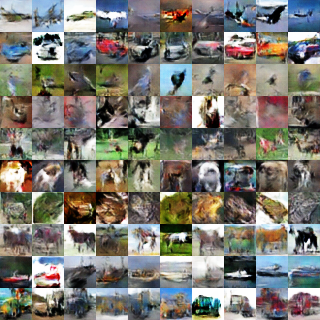

[346/1000][1860/1875][125000] Loss_D: -1.758958 Loss_G: 0.161019 
Loss_D_real: 1.762681 Loss_D_fake 0.003723 Loss_C_fake 0.000815 18911.6038749218
[348/1000][705/1875][125500] Loss_D: -2.331222 Loss_G: 1.658552 
Loss_D_real: 0.556926 Loss_D_fake -1.774297 Loss_C_fake 0.002475 18987.041131734848
[349/1000][1425/1875][126000] Loss_D: -3.425472 Loss_G: -0.211486 
Loss_D_real: 3.018358 Loss_D_fake -0.407114 Loss_C_fake 0.048736 19062.480419397354
[351/1000][270/1875][126500] Loss_D: -2.314001 Loss_G: 0.699217 
Loss_D_real: 1.754110 Loss_D_fake -0.559891 Loss_C_fake 0.156853 19137.91707253456
[352/1000][990/1875][127000] Loss_D: -2.502243 Loss_G: 0.677815 
Loss_D_real: 1.464298 Loss_D_fake -1.037944 Loss_C_fake 0.055044 19213.351374149323


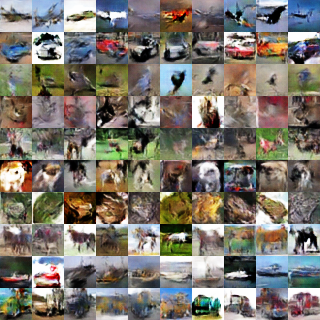

[353/1000][1710/1875][127500] Loss_D: -2.125821 Loss_G: 2.513332 
Loss_D_real: -0.348839 Loss_D_fake -2.474660 Loss_C_fake 0.007304 19288.82619857788
[355/1000][555/1875][128000] Loss_D: -1.629073 Loss_G: -0.055832 
Loss_D_real: 2.017365 Loss_D_fake 0.388292 Loss_C_fake 0.001964 19364.261859178543
[356/1000][1275/1875][128500] Loss_D: -1.864843 Loss_G: 1.882037 
Loss_D_real: -0.285711 Loss_D_fake -2.150554 Loss_C_fake 0.001441 19439.69732427597
[358/1000][120/1875][129000] Loss_D: -1.848518 Loss_G: -1.056759 
Loss_D_real: 2.639696 Loss_D_fake 0.791178 Loss_C_fake 0.028628 19515.14235520363
[359/1000][840/1875][129500] Loss_D: -1.975343 Loss_G: 0.730509 
Loss_D_real: 0.834116 Loss_D_fake -1.141227 Loss_C_fake 0.001694 19590.57630610466


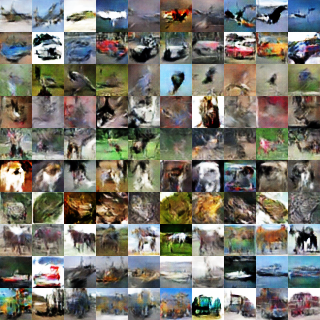

[360/1000][1560/1875][130000] Loss_D: -2.218717 Loss_G: 2.673995 
Loss_D_real: -0.264107 Loss_D_fake -2.482824 Loss_C_fake 0.000430 19666.039216518402
[362/1000][405/1875][130500] Loss_D: -2.009511 Loss_G: 0.697358 
Loss_D_real: 1.243009 Loss_D_fake -0.766502 Loss_C_fake 0.000763 19741.47569322586
[363/1000][1125/1875][131000] Loss_D: -1.557512 Loss_G: 1.174523 
Loss_D_real: 0.847758 Loss_D_fake -0.709754 Loss_C_fake 0.016932 19816.908610105515
[364/1000][1845/1875][131500] Loss_D: -2.057122 Loss_G: -0.479399 
Loss_D_real: 2.568568 Loss_D_fake 0.511446 Loss_C_fake 0.122671 19892.346586227417
[366/1000][690/1875][132000] Loss_D: -1.830485 Loss_G: 0.193867 
Loss_D_real: 1.741345 Loss_D_fake -0.089140 Loss_C_fake 0.256486 19967.785111427307


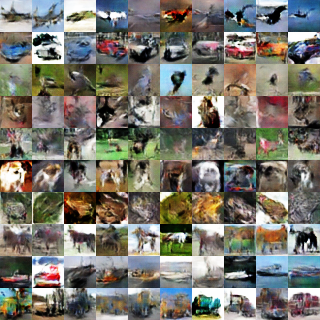

[367/1000][1410/1875][132500] Loss_D: -1.878976 Loss_G: -2.074374 
Loss_D_real: 3.665309 Loss_D_fake 1.786333 Loss_C_fake 0.100217 20043.252732276917
[369/1000][255/1875][133000] Loss_D: -1.786402 Loss_G: 0.951370 
Loss_D_real: 0.126666 Loss_D_fake -1.659736 Loss_C_fake 0.000062 20118.690104722977
[370/1000][975/1875][133500] Loss_D: -1.889354 Loss_G: 1.146048 
Loss_D_real: 0.552425 Loss_D_fake -1.336929 Loss_C_fake 0.019530 20194.137280464172
[371/1000][1695/1875][134000] Loss_D: -2.132736 Loss_G: 1.625187 
Loss_D_real: 0.491861 Loss_D_fake -1.640875 Loss_C_fake 0.044284 20269.57238149643
[373/1000][540/1875][134500] Loss_D: -2.179082 Loss_G: 1.622438 
Loss_D_real: 0.754297 Loss_D_fake -1.424786 Loss_C_fake 0.015493 20345.00640654564


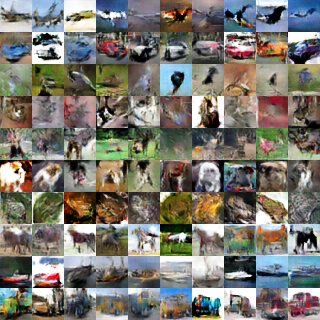

[374/1000][1260/1875][135000] Loss_D: -1.929810 Loss_G: 1.800531 
Loss_D_real: 0.052667 Loss_D_fake -1.877143 Loss_C_fake 0.163413 20420.452763080597
[376/1000][105/1875][135500] Loss_D: -2.314329 Loss_G: 1.157176 
Loss_D_real: 1.519101 Loss_D_fake -0.795228 Loss_C_fake 0.040480 20495.889617681503
[377/1000][825/1875][136000] Loss_D: -2.677524 Loss_G: -0.116561 
Loss_D_real: 1.063160 Loss_D_fake -1.614363 Loss_C_fake 0.110728 20571.3298535347
[378/1000][1545/1875][136500] Loss_D: -1.843449 Loss_G: 1.954249 
Loss_D_real: -0.127938 Loss_D_fake -1.971386 Loss_C_fake 0.164561 20646.774003744125
[380/1000][390/1875][137000] Loss_D: -2.076826 Loss_G: -0.147919 
Loss_D_real: 2.878806 Loss_D_fake 0.801980 Loss_C_fake 0.000275 20722.214862585068


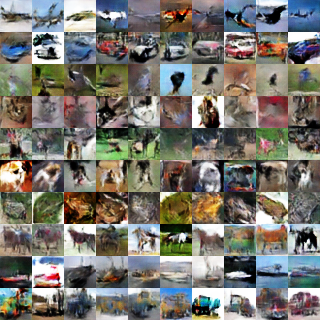

[381/1000][1110/1875][137500] Loss_D: -2.075518 Loss_G: 0.680743 
Loss_D_real: 1.853488 Loss_D_fake -0.222029 Loss_C_fake 0.000063 20797.672121286392
[382/1000][1830/1875][138000] Loss_D: -1.676625 Loss_G: -0.069298 
Loss_D_real: 2.401360 Loss_D_fake 0.724735 Loss_C_fake 0.020174 20873.108454942703
[384/1000][675/1875][138500] Loss_D: -2.307123 Loss_G: 0.391233 
Loss_D_real: 1.533211 Loss_D_fake -0.773912 Loss_C_fake 0.011158 20948.542005300522
[385/1000][1395/1875][139000] Loss_D: -1.773008 Loss_G: -1.366119 
Loss_D_real: 2.843944 Loss_D_fake 1.070936 Loss_C_fake 0.001573 21023.980570554733
[387/1000][240/1875][139500] Loss_D: -1.958913 Loss_G: -0.143767 
Loss_D_real: 2.332564 Loss_D_fake 0.373651 Loss_C_fake 0.004967 21099.404098272324


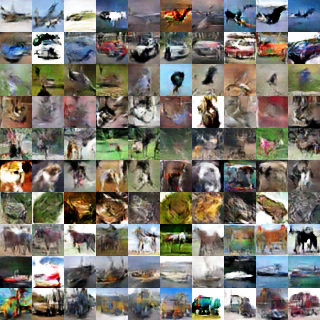

[388/1000][960/1875][140000] Loss_D: -2.175908 Loss_G: 0.119339 
Loss_D_real: 1.904249 Loss_D_fake -0.271659 Loss_C_fake 0.115838 21174.87176823616
[389/1000][1680/1875][140500] Loss_D: -2.478607 Loss_G: 1.732579 
Loss_D_real: 1.416003 Loss_D_fake -1.062604 Loss_C_fake 0.223478 21250.31041407585
[391/1000][525/1875][141000] Loss_D: -2.404266 Loss_G: 2.685185 
Loss_D_real: -0.168050 Loss_D_fake -2.572316 Loss_C_fake 0.110543 21325.74994659424
[392/1000][1245/1875][141500] Loss_D: -1.171917 Loss_G: 0.785259 
Loss_D_real: 0.596939 Loss_D_fake -0.574978 Loss_C_fake 0.003489 21401.179413557053
[393/1000][1875/1875][142000] Loss_D: -2.044016 Loss_G: -1.463987 
Loss_D_real: 3.073198 Loss_D_fake 1.029182 Loss_C_fake 0.009996 21474.170399427414


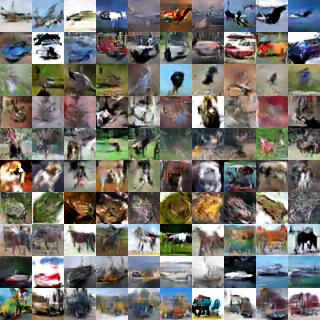

[395/1000][720/1875][142500] Loss_D: -1.877976 Loss_G: 0.325299 
Loss_D_real: 1.615313 Loss_D_fake -0.262664 Loss_C_fake 0.032491 21549.639117717743
[396/1000][1440/1875][143000] Loss_D: -1.891380 Loss_G: 0.375963 
Loss_D_real: 1.410338 Loss_D_fake -0.481042 Loss_C_fake 0.016051 21625.072488069534
[398/1000][285/1875][143500] Loss_D: -1.261792 Loss_G: 0.853002 
Loss_D_real: 0.971791 Loss_D_fake -0.290002 Loss_C_fake 0.145090 21700.50523877144
[399/1000][1005/1875][144000] Loss_D: -1.723593 Loss_G: -0.349699 
Loss_D_real: 2.338929 Loss_D_fake 0.615336 Loss_C_fake 0.078327 21775.943410158157
[400/1000][1725/1875][144500] Loss_D: -1.900101 Loss_G: -1.417758 
Loss_D_real: 2.970124 Loss_D_fake 1.070023 Loss_C_fake 0.012773 21851.381617307663


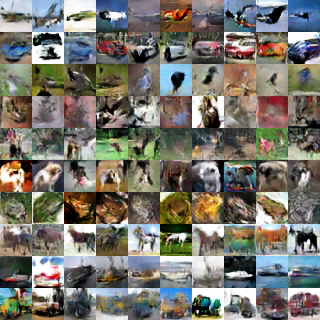

[402/1000][570/1875][145000] Loss_D: -1.812813 Loss_G: 1.811891 
Loss_D_real: -0.107702 Loss_D_fake -1.920515 Loss_C_fake 0.002299 21926.84688925743
[403/1000][1290/1875][145500] Loss_D: -1.606189 Loss_G: 0.654972 
Loss_D_real: 1.362984 Loss_D_fake -0.243205 Loss_C_fake 0.218152 22002.277676582336
[405/1000][135/1875][146000] Loss_D: -1.846958 Loss_G: 0.550164 
Loss_D_real: 1.395949 Loss_D_fake -0.451009 Loss_C_fake 0.045905 22077.7178709507
[406/1000][855/1875][146500] Loss_D: -1.980658 Loss_G: -0.463900 
Loss_D_real: 2.097337 Loss_D_fake 0.116679 Loss_C_fake 0.036758 22153.160600423813
[407/1000][1575/1875][147000] Loss_D: -2.014230 Loss_G: 0.582393 
Loss_D_real: 1.172463 Loss_D_fake -0.841766 Loss_C_fake 0.001523 22228.594324350357


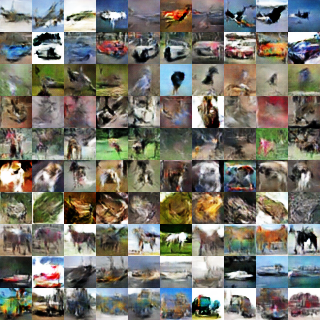

[409/1000][420/1875][147500] Loss_D: -2.276115 Loss_G: -0.901005 
Loss_D_real: 2.847277 Loss_D_fake 0.571162 Loss_C_fake 0.120739 22304.055430412292
[410/1000][1140/1875][148000] Loss_D: -2.185724 Loss_G: 1.118157 
Loss_D_real: 0.747369 Loss_D_fake -1.438355 Loss_C_fake 0.055991 22379.485222816467
[411/1000][1860/1875][148500] Loss_D: -1.531313 Loss_G: 0.695171 
Loss_D_real: 0.701158 Loss_D_fake -0.830156 Loss_C_fake 0.000684 22454.922293424606
[413/1000][705/1875][149000] Loss_D: -2.519992 Loss_G: 0.041920 
Loss_D_real: 2.105872 Loss_D_fake -0.414120 Loss_C_fake 0.000399 22530.350678682327
[414/1000][1425/1875][149500] Loss_D: -2.184510 Loss_G: 0.205842 
Loss_D_real: 2.044748 Loss_D_fake -0.139762 Loss_C_fake 0.221036 22605.786789655685


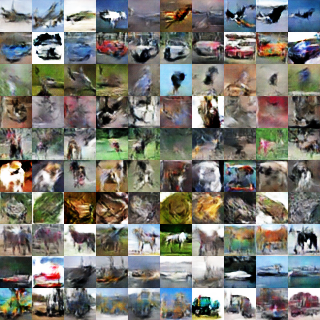

[416/1000][270/1875][150000] Loss_D: -2.717740 Loss_G: 0.622109 
Loss_D_real: 2.309845 Loss_D_fake -0.407894 Loss_C_fake 0.165632 22681.254321813583
[417/1000][990/1875][150500] Loss_D: -2.073391 Loss_G: 0.173372 
Loss_D_real: 1.957772 Loss_D_fake -0.115619 Loss_C_fake 0.292608 22756.695534944534
[418/1000][1710/1875][151000] Loss_D: -1.882763 Loss_G: 2.425354 
Loss_D_real: -0.383882 Loss_D_fake -2.266645 Loss_C_fake 0.000010 22832.13312602043
[420/1000][555/1875][151500] Loss_D: -1.838571 Loss_G: 1.957766 
Loss_D_real: 0.550440 Loss_D_fake -1.288131 Loss_C_fake 0.364030 22907.568610191345
[421/1000][1275/1875][152000] Loss_D: -1.539569 Loss_G: -0.054175 
Loss_D_real: 1.497335 Loss_D_fake -0.042234 Loss_C_fake 0.000145 22983.010870695114


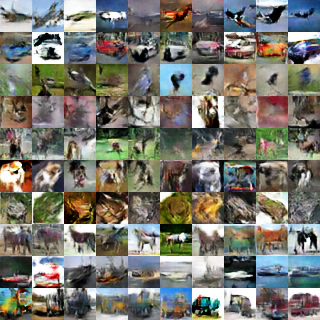

[423/1000][120/1875][152500] Loss_D: -1.463290 Loss_G: 0.497130 
Loss_D_real: 0.834237 Loss_D_fake -0.629053 Loss_C_fake 0.358983 23058.474895715714
[424/1000][840/1875][153000] Loss_D: -1.536583 Loss_G: 0.871450 
Loss_D_real: 1.129442 Loss_D_fake -0.407141 Loss_C_fake 0.144316 23133.90692448616
[425/1000][1560/1875][153500] Loss_D: -2.357268 Loss_G: 2.155223 
Loss_D_real: -0.187385 Loss_D_fake -2.544653 Loss_C_fake 0.008513 23209.347015619278
[427/1000][405/1875][154000] Loss_D: -1.849080 Loss_G: -1.459574 
Loss_D_real: 3.091455 Loss_D_fake 1.242374 Loss_C_fake 0.187397 23284.79046702385
[428/1000][1125/1875][154500] Loss_D: -1.661829 Loss_G: 0.146474 
Loss_D_real: 1.893926 Loss_D_fake 0.232097 Loss_C_fake 0.000240 23360.2230386734


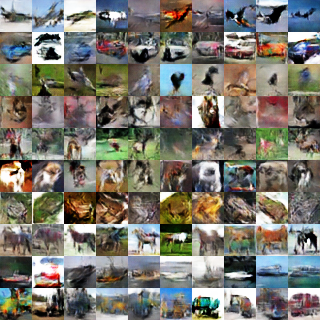

[429/1000][1845/1875][155000] Loss_D: -1.921601 Loss_G: 0.297059 
Loss_D_real: 1.834747 Loss_D_fake -0.086854 Loss_C_fake 0.142536 23435.69192814827
[431/1000][690/1875][155500] Loss_D: -2.054406 Loss_G: 1.751837 
Loss_D_real: 0.448122 Loss_D_fake -1.606284 Loss_C_fake 0.009242 23511.136343479156
[432/1000][1410/1875][156000] Loss_D: -1.838901 Loss_G: -2.482744 
Loss_D_real: 3.846759 Loss_D_fake 2.007858 Loss_C_fake 0.002821 23586.56454205513
[434/1000][255/1875][156500] Loss_D: -1.739091 Loss_G: 0.718373 
Loss_D_real: 1.111364 Loss_D_fake -0.627727 Loss_C_fake 0.018026 23662.00483059883
[435/1000][975/1875][157000] Loss_D: -1.818430 Loss_G: 0.713709 
Loss_D_real: 1.229957 Loss_D_fake -0.588473 Loss_C_fake 0.096274 23737.440733909607


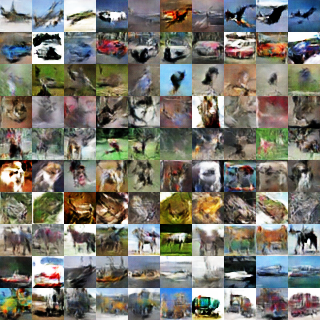

[436/1000][1695/1875][157500] Loss_D: -1.668648 Loss_G: 0.929777 
Loss_D_real: 0.677934 Loss_D_fake -0.990715 Loss_C_fake 0.108157 23812.901743650436
[438/1000][540/1875][158000] Loss_D: -2.036605 Loss_G: 0.229267 
Loss_D_real: 1.138961 Loss_D_fake -0.897644 Loss_C_fake 0.230011 23888.335691928864
[439/1000][1260/1875][158500] Loss_D: -1.673638 Loss_G: 1.539300 
Loss_D_real: 0.087070 Loss_D_fake -1.586568 Loss_C_fake 0.299433 23963.77477002144
[441/1000][105/1875][159000] Loss_D: -1.944562 Loss_G: 0.161062 
Loss_D_real: 1.672794 Loss_D_fake -0.271768 Loss_C_fake 0.046653 24039.20114016533
[442/1000][825/1875][159500] Loss_D: -1.874689 Loss_G: 2.544096 
Loss_D_real: -1.280487 Loss_D_fake -3.155176 Loss_C_fake 0.000214 24114.64104270935


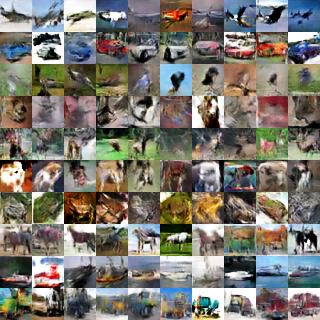

[443/1000][1545/1875][160000] Loss_D: -1.815970 Loss_G: 2.827305 
Loss_D_real: -0.760233 Loss_D_fake -2.576204 Loss_C_fake 0.119591 24190.106103658676
[445/1000][390/1875][160500] Loss_D: -2.102991 Loss_G: 1.759483 
Loss_D_real: 0.701206 Loss_D_fake -1.401786 Loss_C_fake 0.023642 24265.548858880997
[446/1000][1110/1875][161000] Loss_D: -2.415573 Loss_G: -0.078018 
Loss_D_real: 1.868253 Loss_D_fake -0.547320 Loss_C_fake 0.019341 24340.980789661407
[447/1000][1830/1875][161500] Loss_D: -1.488070 Loss_G: -0.567256 
Loss_D_real: 2.703344 Loss_D_fake 1.215274 Loss_C_fake 0.629775 24416.41544675827
[449/1000][675/1875][162000] Loss_D: -1.911644 Loss_G: 1.276385 
Loss_D_real: 0.334601 Loss_D_fake -1.577043 Loss_C_fake 0.006874 24491.84531545639


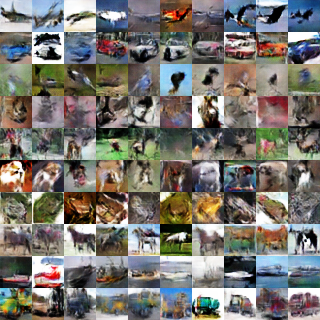

[450/1000][1395/1875][162500] Loss_D: -1.779244 Loss_G: -1.902158 
Loss_D_real: 3.556823 Loss_D_fake 1.777579 Loss_C_fake 0.008031 24567.314886808395
[452/1000][240/1875][163000] Loss_D: -1.916939 Loss_G: 1.333621 
Loss_D_real: 0.876325 Loss_D_fake -1.040614 Loss_C_fake 0.073851 24642.75453519821
[453/1000][960/1875][163500] Loss_D: -2.282827 Loss_G: -1.132471 
Loss_D_real: 3.116186 Loss_D_fake 0.833359 Loss_C_fake 0.089046 24718.185737133026
[454/1000][1680/1875][164000] Loss_D: -2.476591 Loss_G: 2.219799 
Loss_D_real: 0.396403 Loss_D_fake -2.080188 Loss_C_fake 0.057282 24793.61935567856
[456/1000][525/1875][164500] Loss_D: -1.794628 Loss_G: 2.101106 
Loss_D_real: 0.342998 Loss_D_fake -1.451631 Loss_C_fake 0.034233 24869.059614896774


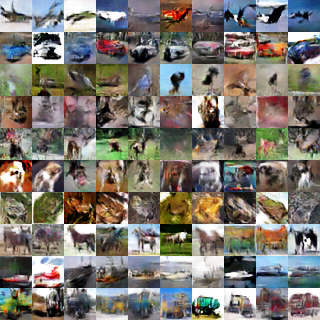

[457/1000][1245/1875][165000] Loss_D: -1.242043 Loss_G: -0.549035 
Loss_D_real: 1.913645 Loss_D_fake 0.671602 Loss_C_fake 0.024686 24944.530534744263
[458/1000][1875/1875][165500] Loss_D: -2.022148 Loss_G: -1.563883 
Loss_D_real: 3.330041 Loss_D_fake 1.307894 Loss_C_fake 0.000260 25017.51831459999
[460/1000][720/1875][166000] Loss_D: -2.074675 Loss_G: 1.635529 
Loss_D_real: 0.614713 Loss_D_fake -1.459961 Loss_C_fake 0.005972 25092.958445072174
[461/1000][1440/1875][166500] Loss_D: -2.119672 Loss_G: -0.241808 
Loss_D_real: 1.956914 Loss_D_fake -0.162758 Loss_C_fake 0.000292 25168.390896320343
[463/1000][285/1875][167000] Loss_D: -1.457291 Loss_G: 1.081270 
Loss_D_real: 0.530685 Loss_D_fake -0.926606 Loss_C_fake 0.315564 25243.828850269318


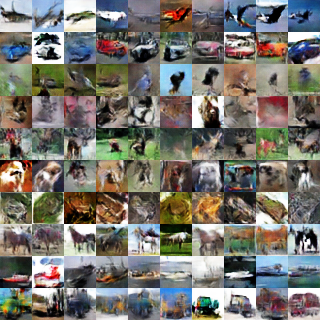

[464/1000][1005/1875][167500] Loss_D: -2.221792 Loss_G: 0.183561 
Loss_D_real: 2.366577 Loss_D_fake 0.144785 Loss_C_fake 0.000000 25319.291491031647
[465/1000][1725/1875][168000] Loss_D: -1.390864 Loss_G: 0.070239 
Loss_D_real: 1.212894 Loss_D_fake -0.177970 Loss_C_fake 0.449078 25394.736951112747
[467/1000][570/1875][168500] Loss_D: -1.993456 Loss_G: 1.420277 
Loss_D_real: 0.349936 Loss_D_fake -1.643520 Loss_C_fake 0.037561 25470.169003248215
[468/1000][1290/1875][169000] Loss_D: -1.730916 Loss_G: 0.660954 
Loss_D_real: 1.193712 Loss_D_fake -0.537204 Loss_C_fake 0.033457 25545.603107213974
[470/1000][135/1875][169500] Loss_D: -1.434002 Loss_G: 0.593916 
Loss_D_real: 1.266179 Loss_D_fake -0.167823 Loss_C_fake 0.078654 25621.046355247498


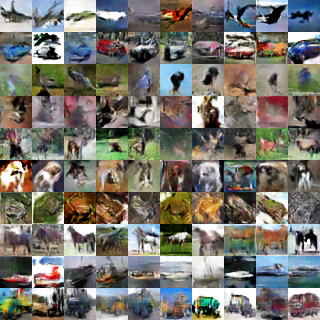

[471/1000][855/1875][170000] Loss_D: -1.535095 Loss_G: -0.895146 
Loss_D_real: 2.962827 Loss_D_fake 1.427732 Loss_C_fake 0.034620 25696.50108909607
[472/1000][1575/1875][170500] Loss_D: -1.557873 Loss_G: 4.040609 
Loss_D_real: -2.002495 Loss_D_fake -3.560368 Loss_C_fake 0.002372 25771.939662456512
[474/1000][420/1875][171000] Loss_D: -1.709250 Loss_G: 0.958075 
Loss_D_real: 1.376130 Loss_D_fake -0.333120 Loss_C_fake 0.019602 25847.378971338272
[475/1000][1140/1875][171500] Loss_D: -1.534182 Loss_G: 1.243666 
Loss_D_real: 0.136537 Loss_D_fake -1.397645 Loss_C_fake 0.268100 25922.81501197815
[476/1000][1860/1875][172000] Loss_D: -1.764714 Loss_G: 0.173780 
Loss_D_real: 1.545301 Loss_D_fake -0.219413 Loss_C_fake 0.001697 25998.25030517578


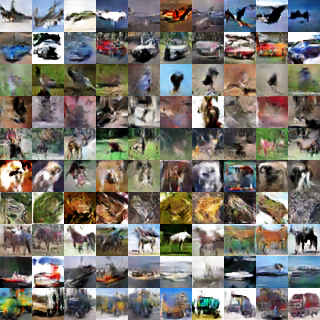

[478/1000][705/1875][172500] Loss_D: -2.140190 Loss_G: 0.465441 
Loss_D_real: 1.944837 Loss_D_fake -0.195353 Loss_C_fake 0.000055 26073.711755990982
[479/1000][1425/1875][173000] Loss_D: -2.249920 Loss_G: -0.701188 
Loss_D_real: 2.742608 Loss_D_fake 0.492688 Loss_C_fake 0.090853 26149.15420794487
[481/1000][270/1875][173500] Loss_D: -2.454646 Loss_G: -0.121578 
Loss_D_real: 2.380698 Loss_D_fake -0.073948 Loss_C_fake 0.044458 26224.58115553856
[482/1000][990/1875][174000] Loss_D: -2.382001 Loss_G: 2.067412 
Loss_D_real: 0.058555 Loss_D_fake -2.323447 Loss_C_fake 0.166619 26300.01668405533
[483/1000][1710/1875][174500] Loss_D: -2.187270 Loss_G: 2.193784 
Loss_D_real: 0.113093 Loss_D_fake -2.074177 Loss_C_fake 0.060242 26375.451504468918


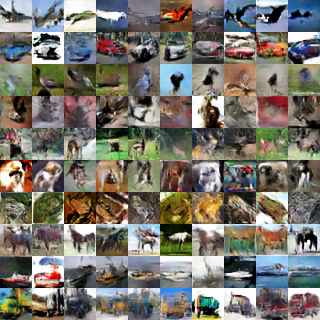

[485/1000][555/1875][175000] Loss_D: -1.916772 Loss_G: 0.204465 
Loss_D_real: 1.523272 Loss_D_fake -0.393500 Loss_C_fake 0.050676 26450.91165280342
[486/1000][1275/1875][175500] Loss_D: -1.673466 Loss_G: 1.582307 
Loss_D_real: -0.354994 Loss_D_fake -2.028460 Loss_C_fake 0.003362 26526.345737695694
[488/1000][120/1875][176000] Loss_D: -1.543433 Loss_G: 0.013141 
Loss_D_real: 1.602142 Loss_D_fake 0.058709 Loss_C_fake 0.038809 26601.782836198807
[489/1000][840/1875][176500] Loss_D: -2.220370 Loss_G: 0.932726 
Loss_D_real: 1.388402 Loss_D_fake -0.831968 Loss_C_fake 0.222849 26677.217012166977
[490/1000][1560/1875][177000] Loss_D: -2.149848 Loss_G: 2.897056 
Loss_D_real: -0.856585 Loss_D_fake -3.006433 Loss_C_fake 0.208934 26752.65391278267


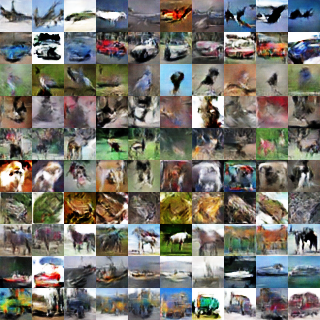

[492/1000][405/1875][177500] Loss_D: -1.564722 Loss_G: 0.397813 
Loss_D_real: 1.212254 Loss_D_fake -0.352468 Loss_C_fake 0.000690 26828.118999242783
[493/1000][1125/1875][178000] Loss_D: -1.563687 Loss_G: 0.508846 
Loss_D_real: 1.463993 Loss_D_fake -0.099694 Loss_C_fake 0.044200 26903.55580830574
[494/1000][1845/1875][178500] Loss_D: -1.710348 Loss_G: -0.874809 
Loss_D_real: 2.430436 Loss_D_fake 0.720088 Loss_C_fake 0.000664 26978.990788698196
[496/1000][690/1875][179000] Loss_D: -2.023635 Loss_G: 1.532278 
Loss_D_real: 0.673353 Loss_D_fake -1.350282 Loss_C_fake 0.000003 27054.43019580841
[497/1000][1410/1875][179500] Loss_D: -1.884934 Loss_G: 0.156508 
Loss_D_real: 1.680795 Loss_D_fake -0.204140 Loss_C_fake 0.036834 27129.868467330933


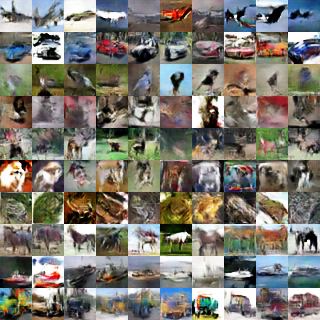

[499/1000][255/1875][180000] Loss_D: -1.631421 Loss_G: 1.555185 
Loss_D_real: -0.593652 Loss_D_fake -2.225073 Loss_C_fake 0.025952 27205.331411123276
[500/1000][975/1875][180500] Loss_D: -1.963885 Loss_G: -0.164465 
Loss_D_real: 1.467571 Loss_D_fake -0.496314 Loss_C_fake 0.029638 27280.7654440403
[501/1000][1695/1875][181000] Loss_D: -2.101133 Loss_G: 2.799700 
Loss_D_real: -0.320251 Loss_D_fake -2.421384 Loss_C_fake 0.165675 27356.192385196686
[503/1000][540/1875][181500] Loss_D: -1.438488 Loss_G: 1.745610 
Loss_D_real: -0.563442 Loss_D_fake -2.001931 Loss_C_fake 0.087422 27431.63426733017
[504/1000][1260/1875][182000] Loss_D: -1.790463 Loss_G: 1.197636 
Loss_D_real: 0.124714 Loss_D_fake -1.665749 Loss_C_fake 0.123326 27507.07181429863


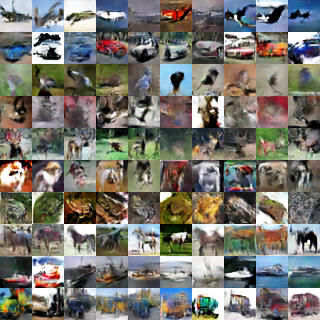

[506/1000][105/1875][182500] Loss_D: -1.842126 Loss_G: -0.068909 
Loss_D_real: 2.089464 Loss_D_fake 0.247338 Loss_C_fake 0.035845 27582.532939195633
[507/1000][825/1875][183000] Loss_D: -2.164539 Loss_G: -0.536950 
Loss_D_real: 1.230854 Loss_D_fake -0.933685 Loss_C_fake 0.151793 27657.967297554016
[508/1000][1545/1875][183500] Loss_D: -2.064522 Loss_G: 2.425239 
Loss_D_real: -0.364903 Loss_D_fake -2.429425 Loss_C_fake 0.080611 27733.395874738693
[510/1000][390/1875][184000] Loss_D: -2.199810 Loss_G: -0.791560 
Loss_D_real: 3.046423 Loss_D_fake 0.846613 Loss_C_fake 0.085387 27808.829031705856
[511/1000][1110/1875][184500] Loss_D: -2.035923 Loss_G: 1.079254 
Loss_D_real: 0.807532 Loss_D_fake -1.228391 Loss_C_fake 0.121109 27884.252908468246


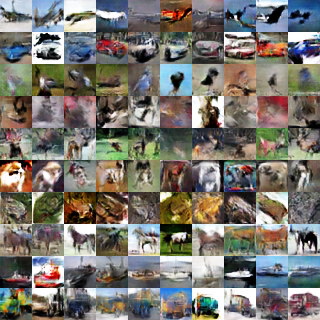

[512/1000][1830/1875][185000] Loss_D: -1.731378 Loss_G: 0.954839 
Loss_D_real: 0.876025 Loss_D_fake -0.855353 Loss_C_fake 0.380797 27959.711055278778
[514/1000][675/1875][185500] Loss_D: -1.979980 Loss_G: 1.276769 
Loss_D_real: 0.523428 Loss_D_fake -1.456552 Loss_C_fake 0.014899 28035.148560762405
[515/1000][1395/1875][186000] Loss_D: -1.631132 Loss_G: -0.727366 
Loss_D_real: 2.079126 Loss_D_fake 0.447994 Loss_C_fake 0.000067 28110.57797241211
[517/1000][240/1875][186500] Loss_D: -1.605289 Loss_G: 0.724718 
Loss_D_real: 1.060958 Loss_D_fake -0.544332 Loss_C_fake 0.031010 28186.011031627655
[518/1000][960/1875][187000] Loss_D: -2.091869 Loss_G: -0.888521 
Loss_D_real: 2.449574 Loss_D_fake 0.357706 Loss_C_fake 0.222588 28261.447304964066


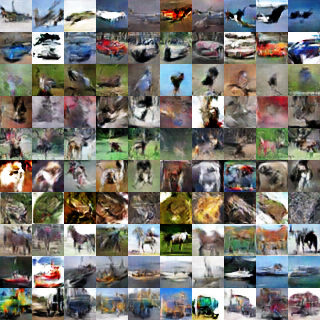

[519/1000][1680/1875][187500] Loss_D: -1.705753 Loss_G: 1.172991 
Loss_D_real: 0.551136 Loss_D_fake -1.154617 Loss_C_fake 0.000224 28336.909523248672
[521/1000][525/1875][188000] Loss_D: -1.957655 Loss_G: 0.799153 
Loss_D_real: 1.350316 Loss_D_fake -0.607339 Loss_C_fake 0.000183 28412.340716838837
[522/1000][1245/1875][188500] Loss_D: -0.965474 Loss_G: 1.563146 
Loss_D_real: -0.307760 Loss_D_fake -1.273234 Loss_C_fake 0.305782 28487.779452323914
[523/1000][1875/1875][189000] Loss_D: -1.626023 Loss_G: -0.608996 
Loss_D_real: 1.766119 Loss_D_fake 0.140096 Loss_C_fake 0.000318 28560.772128582
[525/1000][720/1875][189500] Loss_D: -2.340616 Loss_G: 2.275104 
Loss_D_real: 0.392269 Loss_D_fake -1.948347 Loss_C_fake 0.114365 28636.21072268486


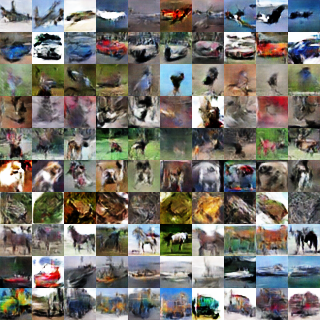

[526/1000][1440/1875][190000] Loss_D: -1.806197 Loss_G: 0.004462 
Loss_D_real: 2.097771 Loss_D_fake 0.291575 Loss_C_fake 0.021533 28711.664423942566
[528/1000][285/1875][190500] Loss_D: -1.817506 Loss_G: 0.782640 
Loss_D_real: 0.896614 Loss_D_fake -0.920892 Loss_C_fake 0.078335 28787.09167265892
[529/1000][1005/1875][191000] Loss_D: -1.904437 Loss_G: 0.631700 
Loss_D_real: 1.586760 Loss_D_fake -0.317677 Loss_C_fake 0.090628 28862.52796626091
[530/1000][1725/1875][191500] Loss_D: -1.509311 Loss_G: -0.497013 
Loss_D_real: 1.926162 Loss_D_fake 0.416850 Loss_C_fake 0.009443 28937.960934638977
[532/1000][570/1875][192000] Loss_D: -1.245945 Loss_G: -0.192436 
Loss_D_real: 1.762080 Loss_D_fake 0.516135 Loss_C_fake 0.261004 29013.40220427513


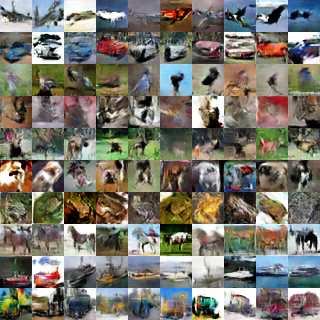

[533/1000][1290/1875][192500] Loss_D: -1.855170 Loss_G: 1.202711 
Loss_D_real: 0.635209 Loss_D_fake -1.219961 Loss_C_fake 0.002406 29088.86450791359
[535/1000][135/1875][193000] Loss_D: -1.522299 Loss_G: 0.307729 
Loss_D_real: 1.567825 Loss_D_fake 0.045525 Loss_C_fake 0.057724 29164.29702425003
[536/1000][855/1875][193500] Loss_D: -1.272219 Loss_G: -1.189150 
Loss_D_real: 2.817866 Loss_D_fake 1.545647 Loss_C_fake 0.000013 29239.719761371613
[537/1000][1575/1875][194000] Loss_D: -1.714094 Loss_G: 2.598014 
Loss_D_real: -1.448720 Loss_D_fake -3.162813 Loss_C_fake 0.338511 29315.162839651108
[539/1000][420/1875][194500] Loss_D: -2.031044 Loss_G: -0.665409 
Loss_D_real: 2.556830 Loss_D_fake 0.525786 Loss_C_fake 0.026243 29390.593822479248


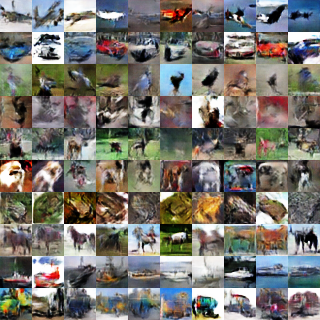

[540/1000][1140/1875][195000] Loss_D: -1.460128 Loss_G: -0.158814 
Loss_D_real: 1.442659 Loss_D_fake -0.017469 Loss_C_fake 0.075354 29466.05095243454
[541/1000][1860/1875][195500] Loss_D: -1.477015 Loss_G: -0.104842 
Loss_D_real: 1.564345 Loss_D_fake 0.087329 Loss_C_fake 0.269933 29541.485500574112
[543/1000][705/1875][196000] Loss_D: -1.967212 Loss_G: 0.277315 
Loss_D_real: 1.886659 Loss_D_fake -0.080553 Loss_C_fake 0.002997 29616.92605781555
[544/1000][1425/1875][196500] Loss_D: -2.455181 Loss_G: -1.920916 
Loss_D_real: 4.140290 Loss_D_fake 1.685110 Loss_C_fake 0.036451 29692.36739206314
[546/1000][270/1875][197000] Loss_D: -1.903299 Loss_G: 0.116503 
Loss_D_real: 1.535026 Loss_D_fake -0.368273 Loss_C_fake 0.000117 29767.80532193184


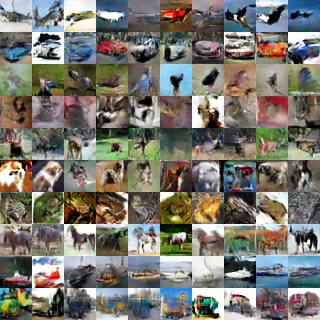

[547/1000][990/1875][197500] Loss_D: -2.009277 Loss_G: -0.200058 
Loss_D_real: 2.250308 Loss_D_fake 0.241031 Loss_C_fake 0.005070 29843.261320114136
[548/1000][1710/1875][198000] Loss_D: -1.679165 Loss_G: 1.684105 
Loss_D_real: 0.054744 Loss_D_fake -1.624421 Loss_C_fake 0.004505 29918.685073137283
[550/1000][555/1875][198500] Loss_D: -1.738646 Loss_G: 1.792846 
Loss_D_real: 0.245468 Loss_D_fake -1.493178 Loss_C_fake 0.001586 29994.11921286583
[551/1000][1275/1875][199000] Loss_D: -1.333532 Loss_G: 1.665663 
Loss_D_real: -0.005418 Loss_D_fake -1.338950 Loss_C_fake 0.024767 30069.54936361313
[553/1000][120/1875][199500] Loss_D: -1.842330 Loss_G: -0.359709 
Loss_D_real: 2.160618 Loss_D_fake 0.318288 Loss_C_fake 0.041506 30144.98219847679


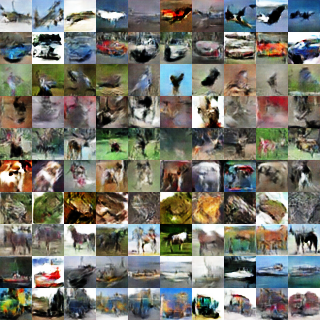

[554/1000][840/1875][200000] Loss_D: -1.850064 Loss_G: -0.401682 
Loss_D_real: 2.093593 Loss_D_fake 0.243530 Loss_C_fake 0.030645 30220.431011915207
[555/1000][1560/1875][200500] Loss_D: -2.145869 Loss_G: 1.029618 
Loss_D_real: 1.252559 Loss_D_fake -0.893310 Loss_C_fake 0.032075 30295.861825942993
[557/1000][405/1875][201000] Loss_D: -1.956763 Loss_G: -0.193055 
Loss_D_real: 2.185098 Loss_D_fake 0.228335 Loss_C_fake 0.056650 30371.28775882721
[558/1000][1125/1875][201500] Loss_D: -1.408482 Loss_G: 0.395744 
Loss_D_real: 1.227244 Loss_D_fake -0.181238 Loss_C_fake 0.067954 30446.718098163605
[559/1000][1845/1875][202000] Loss_D: -1.713793 Loss_G: -0.470389 
Loss_D_real: 2.136324 Loss_D_fake 0.422531 Loss_C_fake 0.523051 30522.15117955208


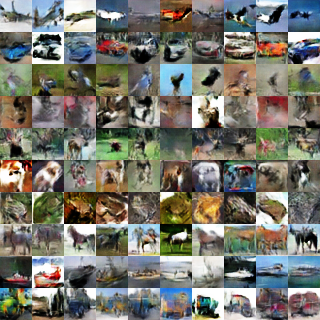

[561/1000][690/1875][202500] Loss_D: -1.634790 Loss_G: 0.645129 
Loss_D_real: 1.743056 Loss_D_fake 0.108266 Loss_C_fake 0.000241 30597.610263824463
[562/1000][1410/1875][203000] Loss_D: -1.872540 Loss_G: -1.180605 
Loss_D_real: 3.075303 Loss_D_fake 1.202763 Loss_C_fake 0.058095 30673.045556783676
[564/1000][255/1875][203500] Loss_D: -1.817627 Loss_G: -0.072558 
Loss_D_real: 1.316478 Loss_D_fake -0.501148 Loss_C_fake 0.005997 30748.47437787056
[565/1000][975/1875][204000] Loss_D: -1.940925 Loss_G: -0.055607 
Loss_D_real: 1.695091 Loss_D_fake -0.245834 Loss_C_fake 0.140179 30823.914404153824
[566/1000][1695/1875][204500] Loss_D: -1.994688 Loss_G: 0.781310 
Loss_D_real: 0.745720 Loss_D_fake -1.248968 Loss_C_fake 0.082967 30899.34109044075


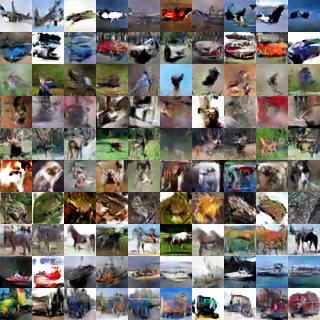

[568/1000][540/1875][205000] Loss_D: -1.857852 Loss_G: 2.221140 
Loss_D_real: -0.941365 Loss_D_fake -2.799217 Loss_C_fake 0.430865 30974.79793858528
[569/1000][1260/1875][205500] Loss_D: -1.407856 Loss_G: 1.436196 
Loss_D_real: -0.154162 Loss_D_fake -1.562019 Loss_C_fake 0.024005 31050.2283744812
[571/1000][105/1875][206000] Loss_D: -1.973170 Loss_G: 0.902726 
Loss_D_real: 0.788053 Loss_D_fake -1.185117 Loss_C_fake 0.102276 31125.667301654816
[572/1000][825/1875][206500] Loss_D: -2.085723 Loss_G: 0.019855 
Loss_D_real: 1.696741 Loss_D_fake -0.388983 Loss_C_fake 0.084884 31201.102454185486
[573/1000][1545/1875][207000] Loss_D: -2.162148 Loss_G: 2.182956 
Loss_D_real: -0.327806 Loss_D_fake -2.489954 Loss_C_fake 0.003065 31276.536767482758


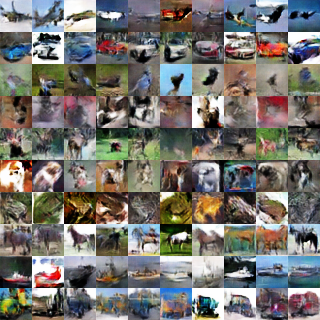

[575/1000][390/1875][207500] Loss_D: -1.822342 Loss_G: 0.194172 
Loss_D_real: 1.923243 Loss_D_fake 0.100901 Loss_C_fake 0.193598 31351.98705291748
[576/1000][1110/1875][208000] Loss_D: -1.954997 Loss_G: 1.942341 
Loss_D_real: 0.500671 Loss_D_fake -1.454326 Loss_C_fake 0.015998 31427.418808698654
[577/1000][1830/1875][208500] Loss_D: -1.697183 Loss_G: -0.804967 
Loss_D_real: 2.423267 Loss_D_fake 0.726084 Loss_C_fake 0.046425 31502.85006093979
[579/1000][675/1875][209000] Loss_D: -2.024406 Loss_G: 1.531026 
Loss_D_real: -0.225973 Loss_D_fake -2.250380 Loss_C_fake 0.000618 31578.276213407516
[580/1000][1395/1875][209500] Loss_D: -1.648227 Loss_G: -0.411331 
Loss_D_real: 1.794249 Loss_D_fake 0.146022 Loss_C_fake 0.000293 31653.70503091812


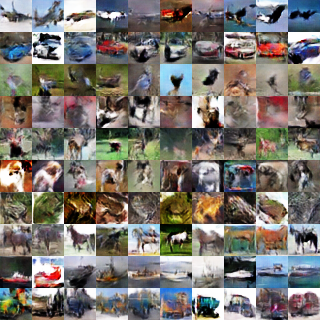

[582/1000][240/1875][210000] Loss_D: -1.740997 Loss_G: 0.652814 
Loss_D_real: 1.306841 Loss_D_fake -0.434156 Loss_C_fake 0.113975 31729.17079281807
[583/1000][960/1875][210500] Loss_D: -2.268250 Loss_G: -0.961590 
Loss_D_real: 3.021261 Loss_D_fake 0.753011 Loss_C_fake 0.001141 31804.600803613663
[584/1000][1680/1875][211000] Loss_D: -1.307074 Loss_G: 0.660212 
Loss_D_real: 0.906597 Loss_D_fake -0.400477 Loss_C_fake 0.004160 31880.02325439453
[586/1000][525/1875][211500] Loss_D: -1.617187 Loss_G: 0.892886 
Loss_D_real: 0.913947 Loss_D_fake -0.703240 Loss_C_fake 0.322033 31955.454463481903
[587/1000][1245/1875][212000] Loss_D: -1.122575 Loss_G: -0.701908 
Loss_D_real: 1.728935 Loss_D_fake 0.606360 Loss_C_fake 0.001801 32030.892823934555


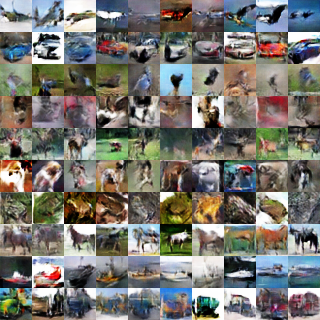

[588/1000][1875/1875][212500] Loss_D: -1.964747 Loss_G: -0.016167 
Loss_D_real: 1.765614 Loss_D_fake -0.199133 Loss_C_fake 0.012601 32103.902025461197
[590/1000][720/1875][213000] Loss_D: -1.712734 Loss_G: 0.793713 
Loss_D_real: 1.615734 Loss_D_fake -0.097001 Loss_C_fake 0.000015 32179.3358669281
[591/1000][1440/1875][213500] Loss_D: -1.689058 Loss_G: -1.038762 
Loss_D_real: 2.588192 Loss_D_fake 0.899134 Loss_C_fake 0.010459 32254.769235372543
[593/1000][285/1875][214000] Loss_D: -1.298730 Loss_G: 0.602896 
Loss_D_real: 1.000948 Loss_D_fake -0.297782 Loss_C_fake 0.063006 32330.20447587967
[594/1000][1005/1875][214500] Loss_D: -1.620114 Loss_G: -0.238506 
Loss_D_real: 1.806061 Loss_D_fake 0.185947 Loss_C_fake 0.281338 32405.63257098198


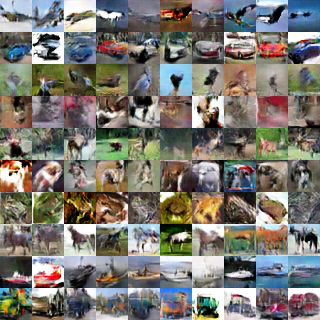

[595/1000][1725/1875][215000] Loss_D: -1.248589 Loss_G: 0.664525 
Loss_D_real: 1.096864 Loss_D_fake -0.151726 Loss_C_fake 0.130556 32481.09440922737
[597/1000][570/1875][215500] Loss_D: -1.682581 Loss_G: 3.031735 
Loss_D_real: -0.363760 Loss_D_fake -2.046341 Loss_C_fake 0.083526 32556.524228811264
[598/1000][1290/1875][216000] Loss_D: -1.700026 Loss_G: 0.380541 
Loss_D_real: 1.589149 Loss_D_fake -0.110877 Loss_C_fake 0.000053 32631.954464673996
[600/1000][135/1875][216500] Loss_D: -1.624200 Loss_G: 1.170733 
Loss_D_real: 0.527268 Loss_D_fake -1.096932 Loss_C_fake 0.214053 32707.393144130707
[601/1000][855/1875][217000] Loss_D: -1.847259 Loss_G: -0.627888 
Loss_D_real: 2.164012 Loss_D_fake 0.316753 Loss_C_fake 0.071120 32782.82885336876


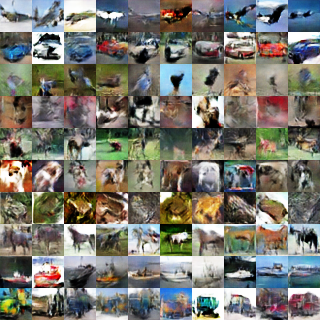

[602/1000][1575/1875][217500] Loss_D: -1.707847 Loss_G: 2.233054 
Loss_D_real: -0.633232 Loss_D_fake -2.341079 Loss_C_fake 0.000037 32858.28876328468
[604/1000][420/1875][218000] Loss_D: -1.811324 Loss_G: 0.360786 
Loss_D_real: 1.829579 Loss_D_fake 0.018256 Loss_C_fake 0.130179 32933.72001695633
[605/1000][1140/1875][218500] Loss_D: -1.289066 Loss_G: 1.450502 
Loss_D_real: -0.240726 Loss_D_fake -1.529792 Loss_C_fake 0.047160 33009.15344119072
[606/1000][1860/1875][219000] Loss_D: -1.351080 Loss_G: 0.857551 
Loss_D_real: 0.638042 Loss_D_fake -0.713037 Loss_C_fake 0.002080 33084.58139920235
[608/1000][705/1875][219500] Loss_D: -1.614478 Loss_G: 1.567858 
Loss_D_real: 0.513861 Loss_D_fake -1.100617 Loss_C_fake 0.001300 33160.01245903969


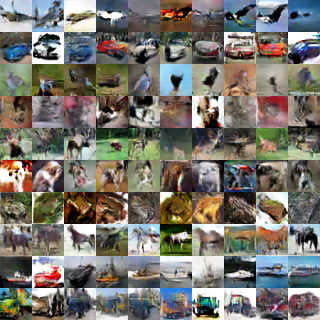

[609/1000][1425/1875][220000] Loss_D: -2.108732 Loss_G: -0.994036 
Loss_D_real: 3.060741 Loss_D_fake 0.952009 Loss_C_fake 0.008554 33235.469370126724
[611/1000][270/1875][220500] Loss_D: -2.147330 Loss_G: -0.413325 
Loss_D_real: 2.225690 Loss_D_fake 0.078360 Loss_C_fake 0.000549 33310.8996591568
[612/1000][990/1875][221000] Loss_D: -1.918612 Loss_G: 0.759498 
Loss_D_real: 1.304261 Loss_D_fake -0.614351 Loss_C_fake 0.085199 33386.32342147827
[613/1000][1710/1875][221500] Loss_D: -1.998034 Loss_G: 1.228129 
Loss_D_real: 0.874735 Loss_D_fake -1.123298 Loss_C_fake 0.000243 33461.76190161705
[615/1000][555/1875][222000] Loss_D: -1.828761 Loss_G: 2.313004 
Loss_D_real: 0.219061 Loss_D_fake -1.609700 Loss_C_fake 0.236991 33537.1981215477


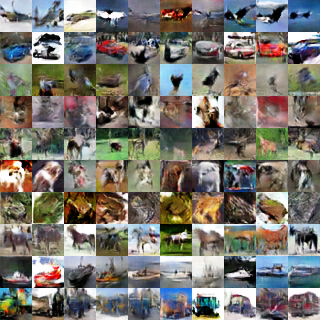

[616/1000][1275/1875][222500] Loss_D: -1.786118 Loss_G: 0.939039 
Loss_D_real: 0.848138 Loss_D_fake -0.937981 Loss_C_fake 0.003108 33612.65329170227
[618/1000][120/1875][223000] Loss_D: -1.646084 Loss_G: 0.135126 
Loss_D_real: 1.230263 Loss_D_fake -0.415821 Loss_C_fake 0.001540 33688.08241343498
[619/1000][840/1875][223500] Loss_D: -1.659924 Loss_G: -1.615763 
Loss_D_real: 2.978336 Loss_D_fake 1.318412 Loss_C_fake 0.000860 33763.51681184769
[620/1000][1560/1875][224000] Loss_D: -2.078501 Loss_G: 3.301043 
Loss_D_real: -0.941210 Loss_D_fake -3.019711 Loss_C_fake 0.049587 33838.95202374458
[622/1000][405/1875][224500] Loss_D: -1.619596 Loss_G: -1.113641 
Loss_D_real: 2.938737 Loss_D_fake 1.319141 Loss_C_fake 0.064603 33914.37858772278


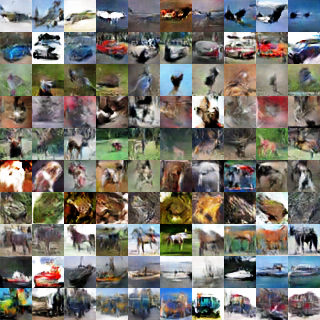

[623/1000][1125/1875][225000] Loss_D: -1.535456 Loss_G: 0.664796 
Loss_D_real: 1.312177 Loss_D_fake -0.223279 Loss_C_fake 0.002957 33989.848809957504
[624/1000][1845/1875][225500] Loss_D: -1.708292 Loss_G: 0.656264 
Loss_D_real: 0.679827 Loss_D_fake -1.028464 Loss_C_fake 0.000157 34065.28393149376
[626/1000][690/1875][226000] Loss_D: -1.652822 Loss_G: 1.891350 
Loss_D_real: 0.208679 Loss_D_fake -1.444143 Loss_C_fake 0.136366 34140.719804763794
[627/1000][1410/1875][226500] Loss_D: -1.649764 Loss_G: -1.185101 
Loss_D_real: 3.049885 Loss_D_fake 1.400121 Loss_C_fake 0.231672 34216.15151357651
[629/1000][255/1875][227000] Loss_D: -1.576596 Loss_G: 0.686112 
Loss_D_real: 0.095776 Loss_D_fake -1.480820 Loss_C_fake 0.079281 34291.57849931717


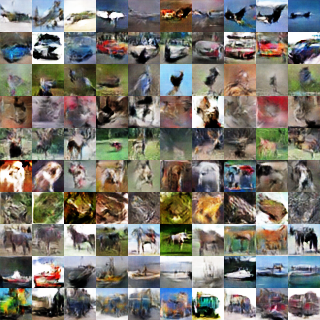

[630/1000][975/1875][227500] Loss_D: -1.651973 Loss_G: 0.616272 
Loss_D_real: 1.288494 Loss_D_fake -0.363479 Loss_C_fake 0.097753 34367.03741598129
[631/1000][1695/1875][228000] Loss_D: -2.002742 Loss_G: 1.563797 
Loss_D_real: 0.708240 Loss_D_fake -1.294502 Loss_C_fake 0.004098 34442.46692919731
[633/1000][540/1875][228500] Loss_D: -1.497512 Loss_G: 1.412780 
Loss_D_real: 0.125149 Loss_D_fake -1.372362 Loss_C_fake 0.162474 34517.900953531265
[634/1000][1260/1875][229000] Loss_D: -1.290520 Loss_G: 1.796764 
Loss_D_real: -0.922307 Loss_D_fake -2.212828 Loss_C_fake 0.357500 34593.32692575455
[636/1000][105/1875][229500] Loss_D: -1.894006 Loss_G: 0.417855 
Loss_D_real: 1.503173 Loss_D_fake -0.390833 Loss_C_fake 0.114992 34668.75521850586


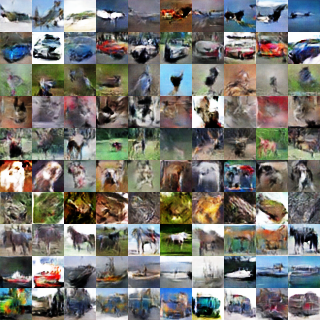

[637/1000][825/1875][230000] Loss_D: -1.798540 Loss_G: -0.593387 
Loss_D_real: 1.643817 Loss_D_fake -0.154723 Loss_C_fake 0.172559 34744.208587646484
[638/1000][1545/1875][230500] Loss_D: -1.844734 Loss_G: 1.636662 
Loss_D_real: -0.085623 Loss_D_fake -1.930357 Loss_C_fake 0.000190 34819.64997577667
[640/1000][390/1875][231000] Loss_D: -2.351155 Loss_G: -1.538253 
Loss_D_real: 3.397996 Loss_D_fake 1.046841 Loss_C_fake 0.195022 34895.08022546768
[641/1000][1110/1875][231500] Loss_D: -1.867639 Loss_G: 1.962471 
Loss_D_real: 0.169967 Loss_D_fake -1.697671 Loss_C_fake 0.005197 34970.51542639732
[642/1000][1830/1875][232000] Loss_D: -1.760482 Loss_G: -0.203840 
Loss_D_real: 2.185077 Loss_D_fake 0.424595 Loss_C_fake 0.003692 35045.95016217232


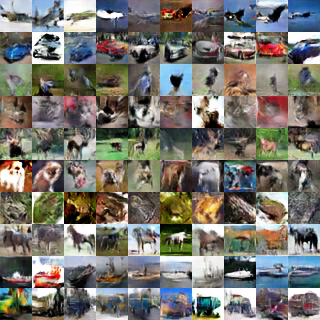

[644/1000][675/1875][232500] Loss_D: -1.869238 Loss_G: 0.737071 
Loss_D_real: 1.044713 Loss_D_fake -0.824525 Loss_C_fake 0.095814 35121.41518449783
[645/1000][1395/1875][233000] Loss_D: -1.937510 Loss_G: -0.586632 
Loss_D_real: 2.270649 Loss_D_fake 0.333139 Loss_C_fake 0.138877 35196.853773117065
[647/1000][240/1875][233500] Loss_D: -1.640829 Loss_G: 0.548430 
Loss_D_real: 1.549283 Loss_D_fake -0.091546 Loss_C_fake 0.085779 35272.292771101
[648/1000][960/1875][234000] Loss_D: -2.341196 Loss_G: 0.443983 
Loss_D_real: 1.930305 Loss_D_fake -0.410890 Loss_C_fake 0.019366 35347.721769571304
[649/1000][1680/1875][234500] Loss_D: -1.532523 Loss_G: 0.011579 
Loss_D_real: 1.523565 Loss_D_fake -0.008958 Loss_C_fake 0.132567 35423.154559612274


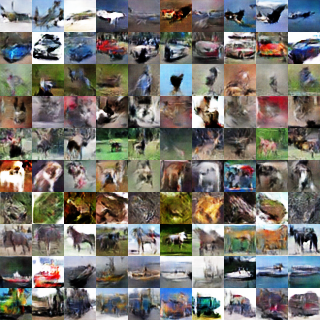

[651/1000][525/1875][235000] Loss_D: -2.093433 Loss_G: 2.618603 
Loss_D_real: -0.472303 Loss_D_fake -2.565736 Loss_C_fake 0.064768 35498.61696791649
[652/1000][1245/1875][235500] Loss_D: -1.150691 Loss_G: -1.046945 
Loss_D_real: 1.937473 Loss_D_fake 0.786782 Loss_C_fake 0.018722 35574.05511069298
[653/1000][1875/1875][236000] Loss_D: -1.439541 Loss_G: 0.119926 
Loss_D_real: 1.102071 Loss_D_fake -0.337471 Loss_C_fake 0.321988 35647.04536342621
[655/1000][720/1875][236500] Loss_D: -1.577153 Loss_G: 1.583950 
Loss_D_real: 0.685135 Loss_D_fake -0.892018 Loss_C_fake 0.258177 35722.475902318954
[656/1000][1440/1875][237000] Loss_D: -1.856072 Loss_G: 0.563214 
Loss_D_real: 1.227545 Loss_D_fake -0.628527 Loss_C_fake 0.101132 35797.9102871418


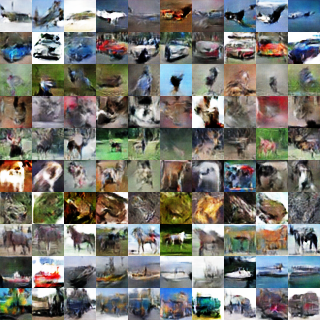

[658/1000][285/1875][237500] Loss_D: -1.533717 Loss_G: -0.168854 
Loss_D_real: 1.626542 Loss_D_fake 0.092825 Loss_C_fake 0.071959 35873.368775606155
[659/1000][1005/1875][238000] Loss_D: -1.508442 Loss_G: 0.766210 
Loss_D_real: 0.607600 Loss_D_fake -0.900842 Loss_C_fake 0.084983 35948.806968450546
[660/1000][1725/1875][238500] Loss_D: -1.630845 Loss_G: 0.435730 
Loss_D_real: 0.974908 Loss_D_fake -0.655937 Loss_C_fake 0.082523 36024.236355781555
[662/1000][570/1875][239000] Loss_D: -1.691571 Loss_G: 1.175509 
Loss_D_real: 0.615035 Loss_D_fake -1.076537 Loss_C_fake 0.002829 36099.67686510086
[663/1000][1290/1875][239500] Loss_D: -1.622455 Loss_G: 0.140646 
Loss_D_real: 0.912615 Loss_D_fake -0.709840 Loss_C_fake 0.104104 36175.11690735817


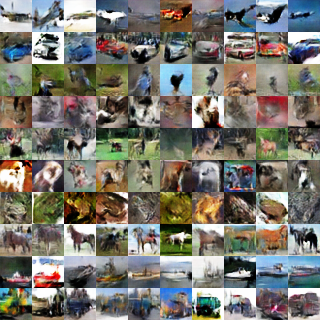

[665/1000][135/1875][240000] Loss_D: -1.554913 Loss_G: 1.277820 
Loss_D_real: 0.303160 Loss_D_fake -1.251753 Loss_C_fake 0.102582 36250.57772684097
[666/1000][855/1875][240500] Loss_D: -1.410821 Loss_G: -0.061208 
Loss_D_real: 1.829347 Loss_D_fake 0.418526 Loss_C_fake 0.101822 36326.01452255249
[667/1000][1575/1875][241000] Loss_D: -2.015052 Loss_G: 3.572840 
Loss_D_real: -1.561158 Loss_D_fake -3.576210 Loss_C_fake 0.232167 36401.45176577568
[669/1000][420/1875][241500] Loss_D: -1.413076 Loss_G: -0.377423 
Loss_D_real: 2.510789 Loss_D_fake 1.097713 Loss_C_fake 0.028017 36476.887550115585
[670/1000][1140/1875][242000] Loss_D: -1.633709 Loss_G: 1.904190 
Loss_D_real: -0.118743 Loss_D_fake -1.752452 Loss_C_fake 0.146665 36552.32051920891


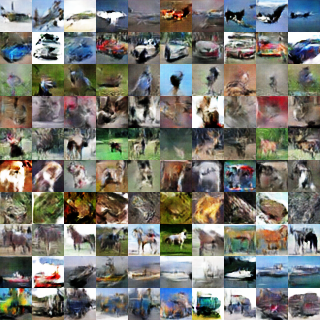

[671/1000][1860/1875][242500] Loss_D: -1.337182 Loss_G: 0.066079 
Loss_D_real: 1.931340 Loss_D_fake 0.594158 Loss_C_fake 0.000167 36627.81160378456
[673/1000][705/1875][243000] Loss_D: -2.260213 Loss_G: -0.184898 
Loss_D_real: 2.253742 Loss_D_fake -0.006472 Loss_C_fake 0.192512 36703.24808263779
[674/1000][1425/1875][243500] Loss_D: -1.874225 Loss_G: -0.872589 
Loss_D_real: 3.206341 Loss_D_fake 1.332116 Loss_C_fake 0.003143 36778.689317941666
[676/1000][270/1875][244000] Loss_D: -2.588683 Loss_G: 2.459428 
Loss_D_real: 0.312312 Loss_D_fake -2.276371 Loss_C_fake 0.012541 36854.12807250023
[677/1000][990/1875][244500] Loss_D: -1.845374 Loss_G: 0.204655 
Loss_D_real: 1.318606 Loss_D_fake -0.526768 Loss_C_fake 0.151133 36929.566670656204


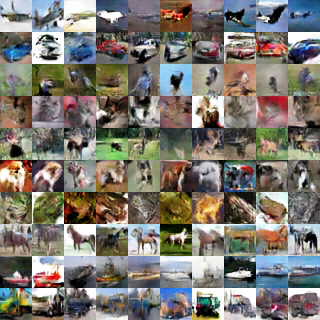

[678/1000][1710/1875][245000] Loss_D: -1.792310 Loss_G: 3.215897 
Loss_D_real: -1.444304 Loss_D_fake -3.236614 Loss_C_fake 0.000011 37005.03131937981
[680/1000][555/1875][245500] Loss_D: -1.995377 Loss_G: 1.404945 
Loss_D_real: 0.432944 Loss_D_fake -1.562433 Loss_C_fake 0.288135 37080.46735024452
[681/1000][1275/1875][246000] Loss_D: -1.918820 Loss_G: -0.084309 
Loss_D_real: 1.523339 Loss_D_fake -0.395481 Loss_C_fake 0.497981 37155.90113115311
[683/1000][120/1875][246500] Loss_D: -1.389131 Loss_G: 1.827952 
Loss_D_real: -0.213273 Loss_D_fake -1.602404 Loss_C_fake 0.000008 37231.33020925522
[684/1000][840/1875][247000] Loss_D: -1.578923 Loss_G: -0.096516 
Loss_D_real: 1.495209 Loss_D_fake -0.083714 Loss_C_fake 0.155857 37306.7629339695


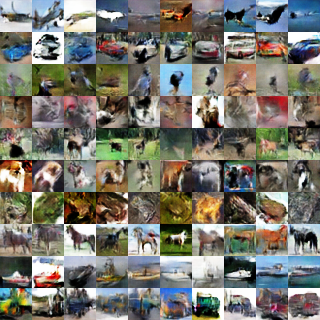

[685/1000][1560/1875][247500] Loss_D: -2.099312 Loss_G: 3.712050 
Loss_D_real: -1.561252 Loss_D_fake -3.660564 Loss_C_fake 0.141042 37382.21083307266
[687/1000][405/1875][248000] Loss_D: -1.736407 Loss_G: -0.325225 
Loss_D_real: 1.879512 Loss_D_fake 0.143106 Loss_C_fake 0.131356 37457.63565135002
[688/1000][1125/1875][248500] Loss_D: -1.932811 Loss_G: -0.032036 
Loss_D_real: 1.701380 Loss_D_fake -0.231431 Loss_C_fake 0.112768 37533.06591844559
[689/1000][1845/1875][249000] Loss_D: -1.800385 Loss_G: 0.249654 
Loss_D_real: 1.944024 Loss_D_fake 0.143639 Loss_C_fake 0.152717 37608.50367307663
[691/1000][690/1875][249500] Loss_D: -1.732704 Loss_G: 0.389836 
Loss_D_real: 1.349625 Loss_D_fake -0.383079 Loss_C_fake 0.000566 37683.94213318825


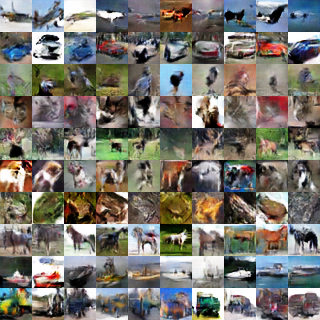

[692/1000][1410/1875][250000] Loss_D: -1.479454 Loss_G: -1.482373 
Loss_D_real: 3.398642 Loss_D_fake 1.919189 Loss_C_fake 0.000139 37759.40211176872
[694/1000][255/1875][250500] Loss_D: -1.680398 Loss_G: 1.251346 
Loss_D_real: -0.139212 Loss_D_fake -1.819610 Loss_C_fake 0.061706 37834.82990479469
[695/1000][975/1875][251000] Loss_D: -1.718607 Loss_G: 1.213035 
Loss_D_real: 0.173503 Loss_D_fake -1.545105 Loss_C_fake 0.052864 37910.253643751144
[696/1000][1695/1875][251500] Loss_D: -1.448829 Loss_G: 0.818115 
Loss_D_real: 1.018816 Loss_D_fake -0.430013 Loss_C_fake 0.078828 37985.67857861519
[698/1000][540/1875][252000] Loss_D: -1.594766 Loss_G: 1.828570 
Loss_D_real: 0.073024 Loss_D_fake -1.521742 Loss_C_fake 0.001175 38061.11275911331


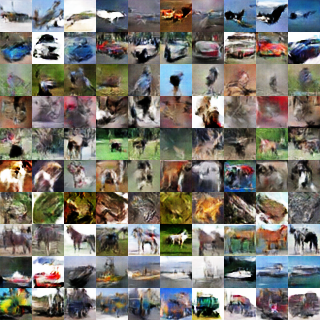

[699/1000][1260/1875][252500] Loss_D: -1.623597 Loss_G: 0.991305 
Loss_D_real: 0.637453 Loss_D_fake -0.986145 Loss_C_fake 0.000573 38136.57103896141
[701/1000][105/1875][253000] Loss_D: -2.068896 Loss_G: 0.169420 
Loss_D_real: 1.319088 Loss_D_fake -0.749808 Loss_C_fake 0.000749 38212.01096057892
[702/1000][825/1875][253500] Loss_D: -1.763518 Loss_G: -0.170390 
Loss_D_real: 1.604114 Loss_D_fake -0.159404 Loss_C_fake 0.001153 38287.43687438965
[703/1000][1545/1875][254000] Loss_D: -1.978489 Loss_G: 1.690931 
Loss_D_real: 0.890867 Loss_D_fake -1.087623 Loss_C_fake 0.001522 38362.87294483185
[705/1000][390/1875][254500] Loss_D: -1.782895 Loss_G: 0.576160 
Loss_D_real: 1.174039 Loss_D_fake -0.608856 Loss_C_fake 0.002338 38438.30228805542


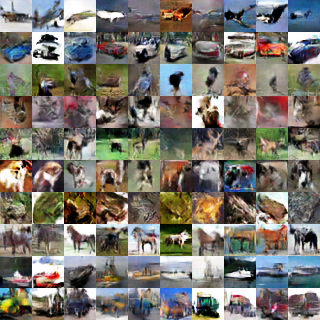

[706/1000][1110/1875][255000] Loss_D: -2.209437 Loss_G: 1.426352 
Loss_D_real: 0.429241 Loss_D_fake -1.780196 Loss_C_fake 0.037220 38513.76085329056
[707/1000][1830/1875][255500] Loss_D: -1.299003 Loss_G: 0.479514 
Loss_D_real: 1.426857 Loss_D_fake 0.127854 Loss_C_fake 0.024320 38589.20035624504
[709/1000][675/1875][256000] Loss_D: -1.897160 Loss_G: 2.015161 
Loss_D_real: -0.040993 Loss_D_fake -1.938153 Loss_C_fake 0.095926 38664.63012576103
[710/1000][1395/1875][256500] Loss_D: -1.975204 Loss_G: -0.775828 
Loss_D_real: 2.713902 Loss_D_fake 0.738698 Loss_C_fake 0.008399 38740.062360048294
[712/1000][240/1875][257000] Loss_D: -1.534072 Loss_G: 1.705576 
Loss_D_real: -0.144900 Loss_D_fake -1.678972 Loss_C_fake 0.051560 38815.4972755909


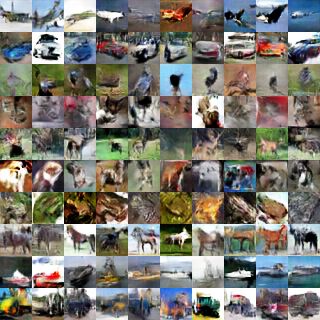

[713/1000][960/1875][257500] Loss_D: -1.861979 Loss_G: 0.549358 
Loss_D_real: 0.992429 Loss_D_fake -0.869549 Loss_C_fake 0.043184 38890.96028017998
[714/1000][1680/1875][258000] Loss_D: -1.955861 Loss_G: 0.547688 
Loss_D_real: 1.542663 Loss_D_fake -0.413198 Loss_C_fake 0.000404 38966.39040660858
[716/1000][525/1875][258500] Loss_D: -1.624727 Loss_G: 2.141671 
Loss_D_real: -0.082182 Loss_D_fake -1.706909 Loss_C_fake 0.224385 39041.82322335243
[717/1000][1245/1875][259000] Loss_D: -1.103698 Loss_G: -0.255816 
Loss_D_real: 1.374236 Loss_D_fake 0.270537 Loss_C_fake 0.040861 39117.25526595116
[718/1000][1875/1875][259500] Loss_D: -1.792794 Loss_G: -1.305534 
Loss_D_real: 2.749936 Loss_D_fake 0.957142 Loss_C_fake 0.032635 39190.35109591484


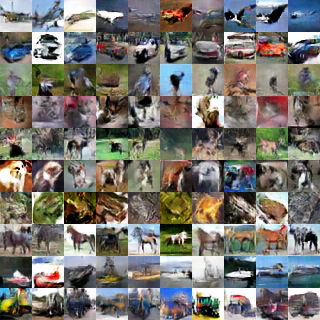

[720/1000][720/1875][260000] Loss_D: -1.691610 Loss_G: 0.853404 
Loss_D_real: 0.704377 Loss_D_fake -0.987232 Loss_C_fake 0.185615 39265.82005286217
[721/1000][1440/1875][260500] Loss_D: -2.442318 Loss_G: -2.192570 
Loss_D_real: 3.757585 Loss_D_fake 1.315267 Loss_C_fake 0.094998 39341.25752401352
[723/1000][285/1875][261000] Loss_D: -1.803351 Loss_G: 2.074710 
Loss_D_real: -0.054071 Loss_D_fake -1.857422 Loss_C_fake 0.000101 39416.696397066116
[724/1000][1005/1875][261500] Loss_D: -1.580708 Loss_G: 0.942420 
Loss_D_real: 0.813781 Loss_D_fake -0.766927 Loss_C_fake 0.128637 39492.134093761444
[725/1000][1725/1875][262000] Loss_D: -1.493089 Loss_G: -0.621648 
Loss_D_real: 1.854866 Loss_D_fake 0.361777 Loss_C_fake 0.011491 39567.568794965744


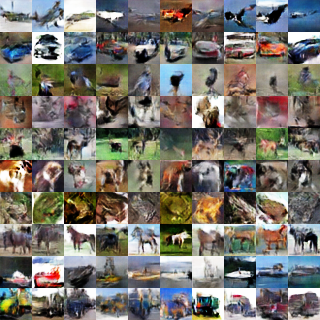

[727/1000][570/1875][262500] Loss_D: -1.917186 Loss_G: 0.555514 
Loss_D_real: 1.068486 Loss_D_fake -0.848700 Loss_C_fake 0.008317 39643.033764600754
[728/1000][1290/1875][263000] Loss_D: -1.677896 Loss_G: 0.826641 
Loss_D_real: 0.830966 Loss_D_fake -0.846929 Loss_C_fake 0.177416 39718.470301389694
[730/1000][135/1875][263500] Loss_D: -1.736533 Loss_G: 1.344224 
Loss_D_real: 1.067733 Loss_D_fake -0.668799 Loss_C_fake 0.000012 39793.906910419464
[731/1000][855/1875][264000] Loss_D: -1.162027 Loss_G: -1.022751 
Loss_D_real: 2.450962 Loss_D_fake 1.288936 Loss_C_fake 0.007964 39869.34092593193


KeyboardInterrupt: 

In [18]:
import time
t0 = time.time()
niter = 1000
gen_iterations = 0
for epoch in range(niter):
    i = 0
    #  每個 epoch 洗牌一下
    #np.random.shuffle(train_X)
    batches = train_X.shape[0]//batchSize
    while i < batches:
        if gen_iterations < 25 or gen_iterations %500 == 0:
            _Diters = 100
        else:
            _Diters = Diters
        j = 0
        while j < _Diters and i < batches:
            j+=1       
            #clamp_D_fn()
            real_data = train_X[i*batchSize:(i+1)*batchSize]
            real_Y = train_Y[i*batchSize:(i+1)*batchSize]
            i+=1        
            noise  = noise_generator(batchSize, nz, n_discrete)
            random_epsilon = np.random.uniform(size=(batchSize, 1,1,1)).astype('float32')
            errD_gp, errD, errD_real, errD_fake, errC_fake = train_D_fn(real_data, noise, real_Y, random_epsilon)
        if gen_iterations%2500 == 0:            
            fake = generator_fn(fixed_noise)
            showX(fake, 10)
            
        noise = noise_generator(batchSize, nz, n_discrete)        
        errG = train_G_fn(noise)[0]
        if gen_iterations%500==0:
            print('[%d/%d][%d/%d][%d] Loss_D: %f Loss_G: %f \nLoss_D_real: %f Loss_D_fake %f Loss_C_fake %f'
            % (epoch, niter, i, batches, gen_iterations,
            errD, errG, errD_real, errD_fake, errC_fake), time.time()-t0)

        gen_iterations+=1

        

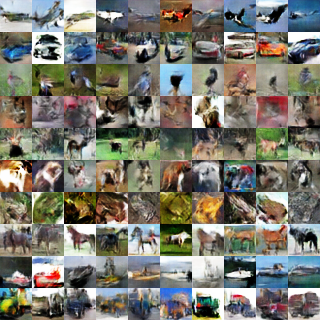

In [19]:
fake = generator_fn(fixed_noise)
showX(fake, 10)